In [1]:
import numpy as np
from pathlib import Path
from graspy.plot import pairplot, heatmap

import sys; sys.path.append('../')
from src.tools import get_files, get_latents
from src.plotting import visualize_embeddings, make_cbar

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
%matplotlib inline
import seaborn as sns
sns.set(color_codes=True, style='white', context='talk', font_scale=1)
PALETTE = sns.color_palette("Set1")

%load_ext autoreload
%autoreload 2

In [21]:
def visualize(path, flag, ftype, n_embed=3, offset=0, n_viz=4, n_plot=6):
    groups, labels, subjs = get_latents(
        path, flag=flag, ids=True, ftype=ftype, as_groups=False
    )
    
    mean = np.mean(np.linalg.norm(groups, axis=1), axis=0)
    std = np.std(np.linalg.norm(groups, axis=1), axis=0)
    print(f"Norm mean: {mean}, std: {std}")
    
    # Hierarchical sorting of subj, state, trait
    key_list = [[l[0] for l in labels], [s for s in subjs], [l[1] for l in labels]]
    key_list = [np.asarray(kl) for kl in key_list]
    idx_list = [np.arange(len(groups))]
    for keys in key_list:
        prior_idx = idx_list
        idx_list = []
        for idxs in prior_idx:
            nkeys = keys[idxs]
            sort_idxs = np.argsort(nkeys)
            nkeys = nkeys[sort_idxs]
            idx_list += [idxs[sort_idxs[np.where(nkeys == k)[0]]] for k in np.unique(nkeys)]
    
    idx = np.hstack(idx_list)
    Xs, subjs, labels = groups[idx], subjs[idx], labels[idx]
    
    if n_viz is None:
        n_viz = Xs.shape[-1]
        
    f, axs = plt.subplots(1, n_viz, figsize=(n_viz*4,4), sharey=True)
    
    label_list = [f'{a} {b}' for a, b in labels]
    for i in range(n_viz):
        ax = axs[i]
        im = ax.imshow(np.corrcoef(Xs[:,:,i+offset]), vmin=0, vmax=1, cmap='Reds')
        if i == n_viz-1:
            divider = make_axes_locatable(ax)
            cax = divider.append_axes("right", size="5%", pad=0.05)
            plt.colorbar(im, cax=cax)
        # plt.colorbar(im, ax=axs[i], cmap='seismic')
    plt.suptitle([label_list[i] for i in sorted(np.unique(label_list, return_index=True)[1])], fontsize=16, y=0.90)

    classes = np.asarray([f"{a} {b}" for a, b in labels])
    f, axs = plt.subplots(1, n_viz, figsize=(n_viz*6,3), sharey=True)
    for i in range(n_viz):
        mean_corrs = np.corrcoef(Xs[:,:,i+offset]).mean(axis=0)
        set_labels, set_means = list(zip(*[(cls, mean_corrs[np.where(classes == cls)[0]]) for cls in np.unique(classes)]))

        sns.boxplot(data=set_means, ax=axs[i])
        axs[i].set_title(f'Gradient {i+1}')
        axs[i].set_ylim([0,1])
        # axs[i].set_yticklabels([])
        axs[i].set_xticklabels(set_labels, rotation=75)

    axs[0].set_ylabel('Mean correlation')

    #axs[-1].set_xticks(plt.xticks()[0], set_labels, kwargs={'rotation': 75})
    plt.suptitle('Mean correlation of scans across groups', y=1.1)
    plt.show()

    SAVE = False
    COLORBAR = True
    
    for i, (X, subj, (trait, state)) in enumerate(zip(Xs, subjs, labels)):
        if i >= n_plot:
            break
        title = f'{subj}: {trait} {state}'
        fig = visualize_embeddings(
            X[:, offset:n_embed+offset],
            save_path=False,
            colorbar=COLORBAR,
            n_embed=n_embed,
            # vmax=vmax,
            title=title,
        )
        plt.show()

## Procrustes o eig o dmap (given)

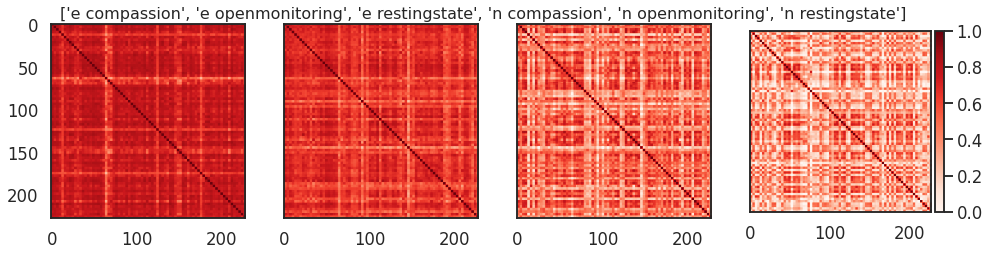

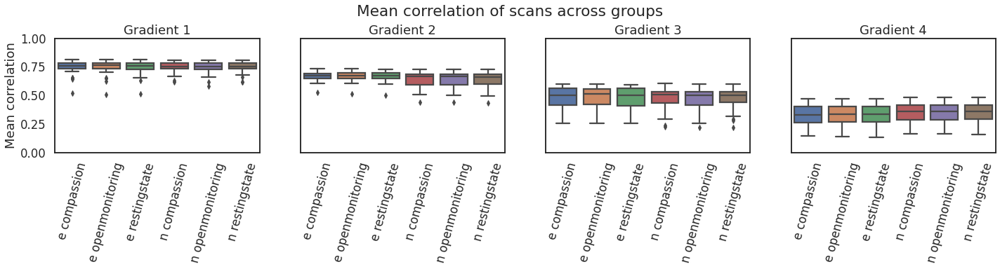

<Figure size 432x288 with 0 Axes>

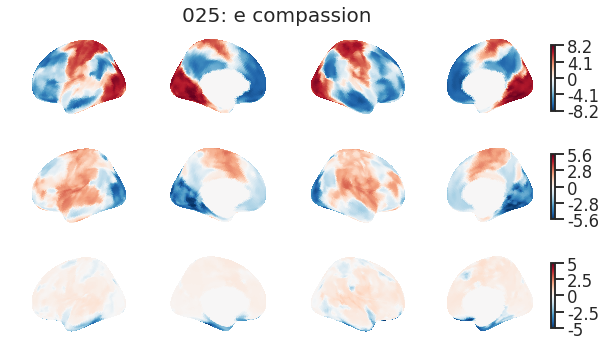

<Figure size 432x288 with 0 Axes>

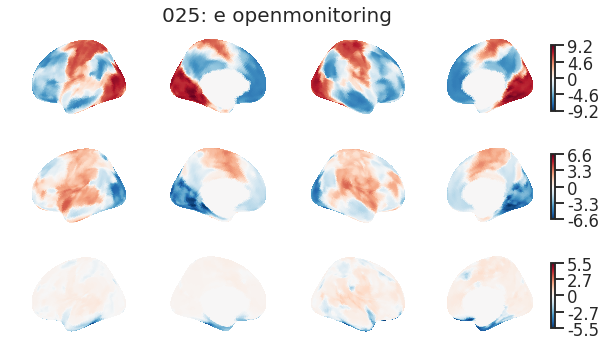

<Figure size 432x288 with 0 Axes>

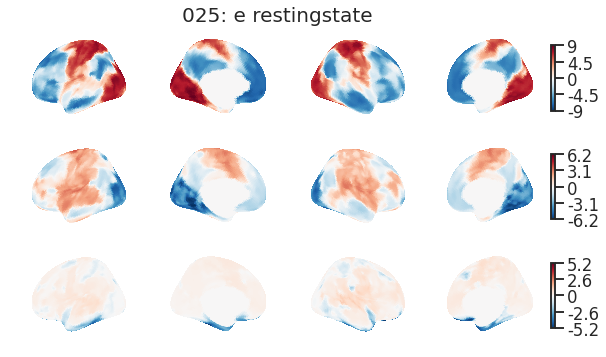

<Figure size 432x288 with 0 Axes>

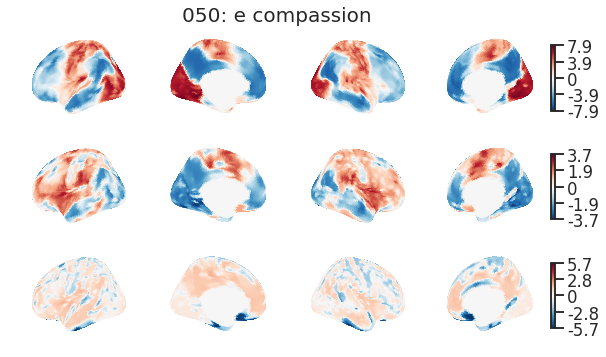

<Figure size 432x288 with 0 Axes>

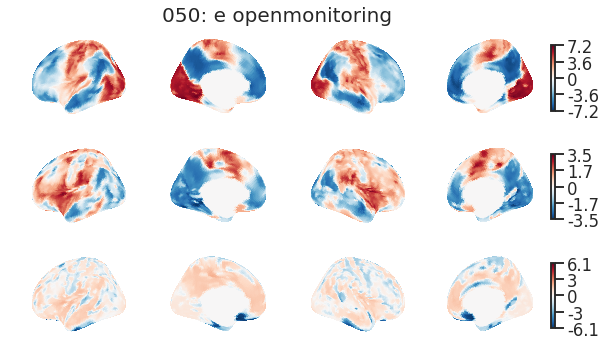

<Figure size 432x288 with 0 Axes>

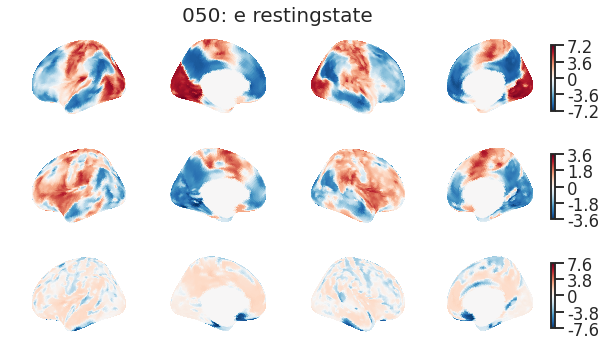

In [14]:
path = Path('/mnt/ssd3/ronan/data/dmap_09-04_aligned')
flag = f"_dmap"
ftype = "h5"
visualize(path, flag, ftype, n_embed=3, n_viz=4, n_plot=6)

## Procrustes o normed o eig o dmap (give)

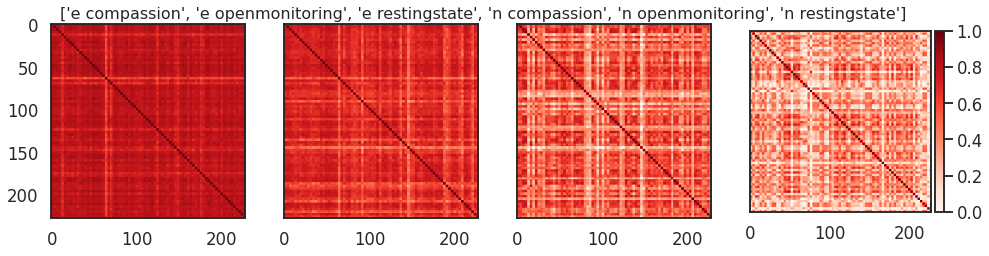

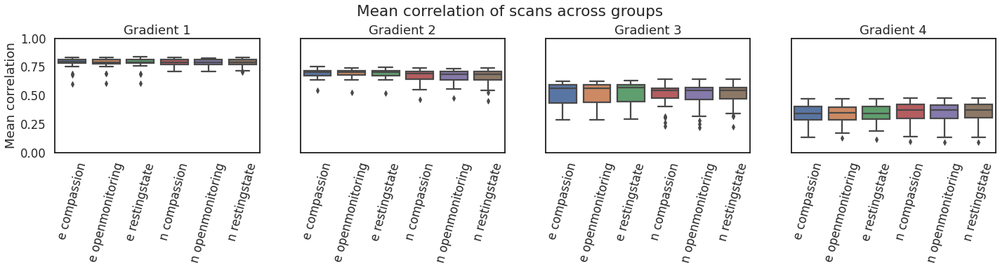

<Figure size 432x288 with 0 Axes>

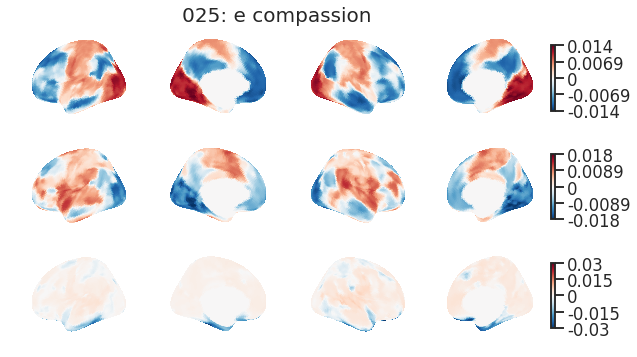

<Figure size 432x288 with 0 Axes>

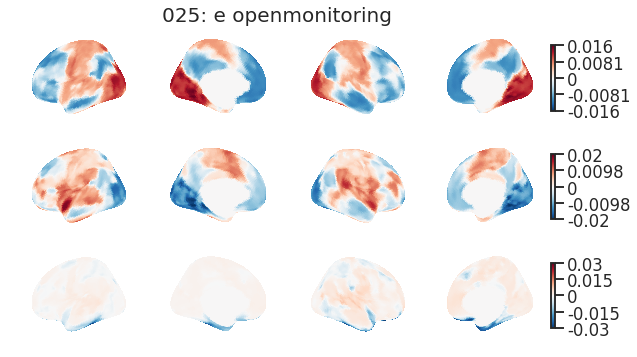

<Figure size 432x288 with 0 Axes>

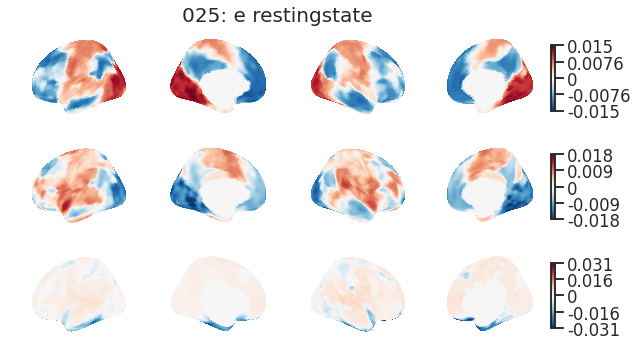

<Figure size 432x288 with 0 Axes>

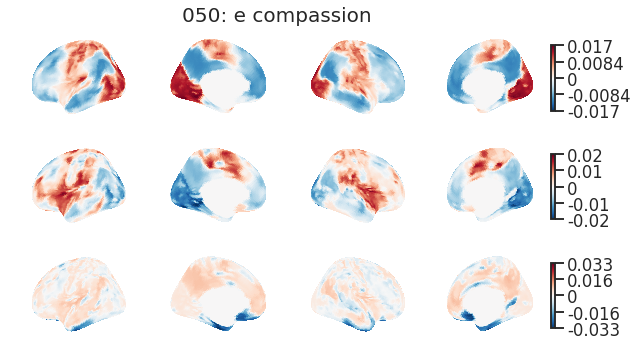

<Figure size 432x288 with 0 Axes>

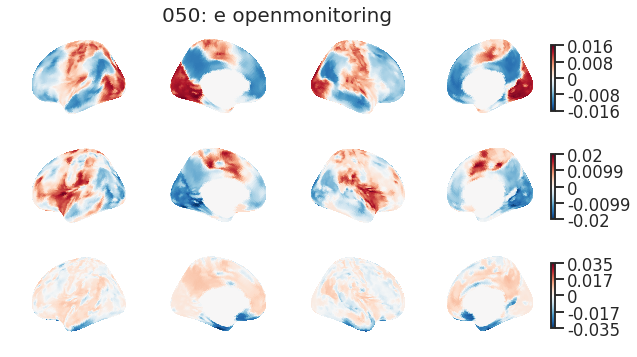

<Figure size 432x288 with 0 Axes>

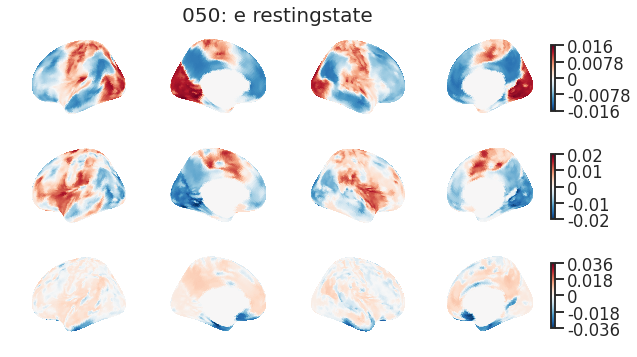

In [15]:
path = Path('/mnt/ssd3/ronan/data/dmap_09-04_aligned_normed')
flag = f"_dmap"
ftype = "h5"
visualize(path, flag, ftype, n_embed=3, n_viz=4, n_plot=6)

## Procrustes o eig o dmap (replicated)

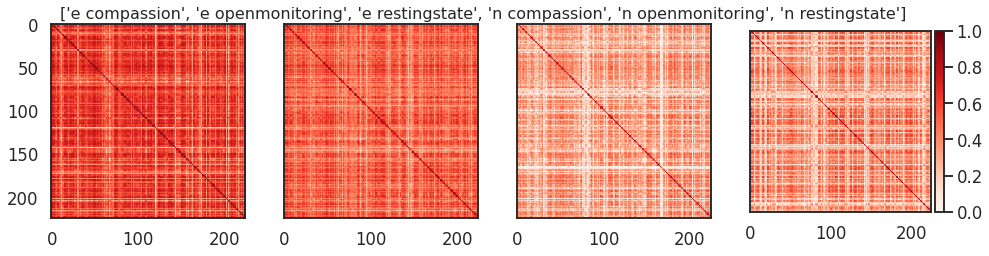

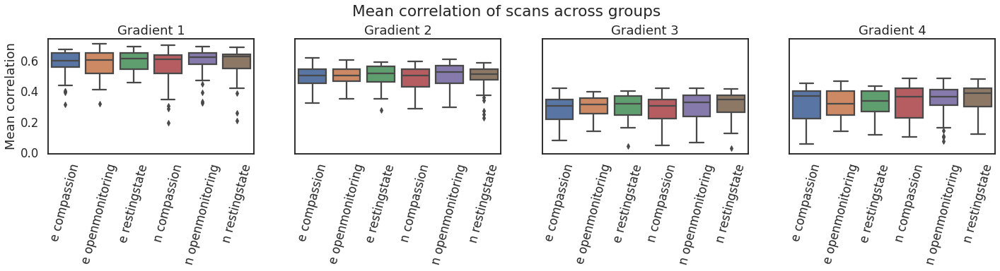

<Figure size 432x288 with 0 Axes>

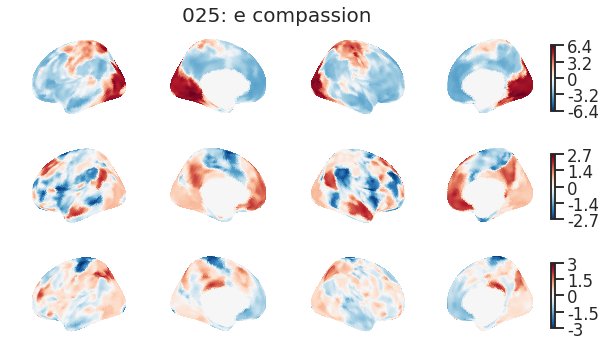

<Figure size 432x288 with 0 Axes>

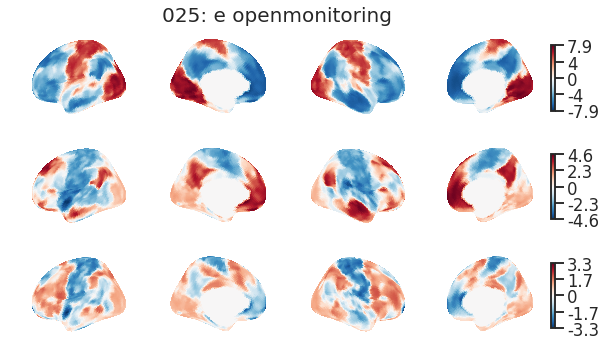

<Figure size 432x288 with 0 Axes>

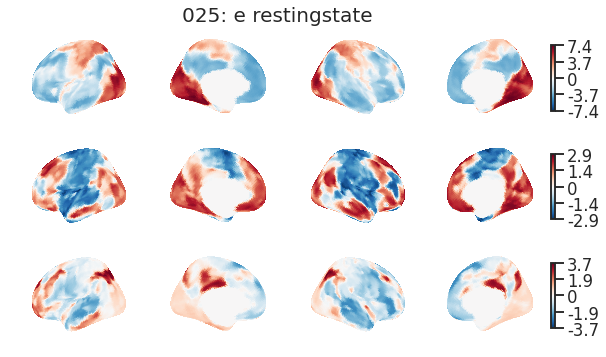

<Figure size 432x288 with 0 Axes>

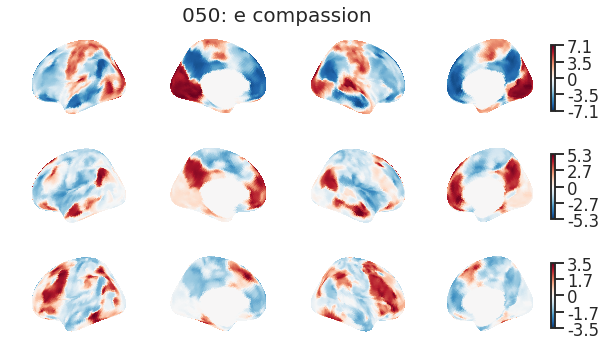

<Figure size 432x288 with 0 Axes>

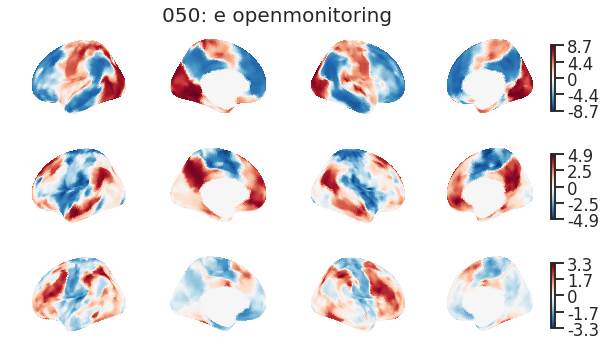

<Figure size 432x288 with 0 Axes>

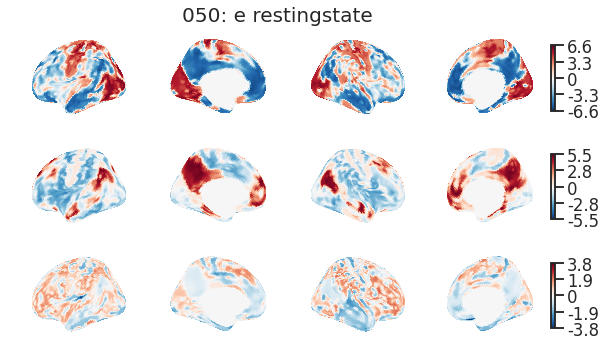

In [169]:
path = Path('/mnt/ssd3/ronan/data/dmap_replication_aligned_12-04')
flag = f"_dmap"
ftype = "h5"
visualize(path, flag, ftype, n_embed=3, n_viz=4, n_plot=6)

## MASE o dmap 

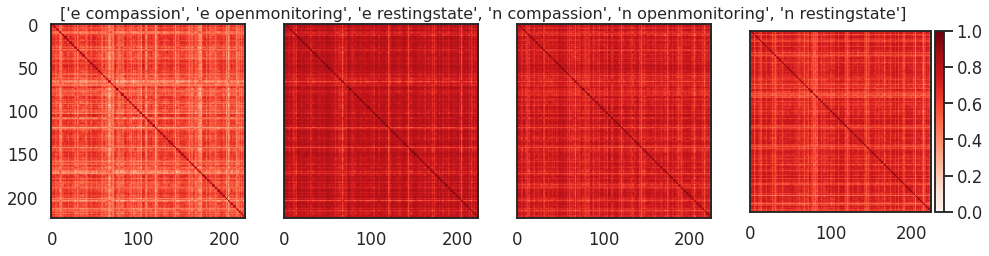

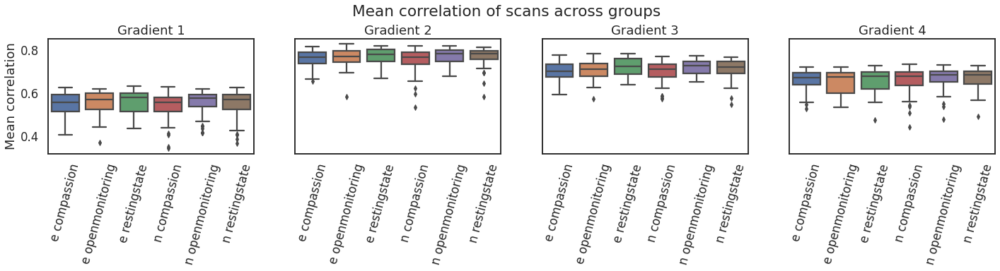

<Figure size 432x288 with 0 Axes>

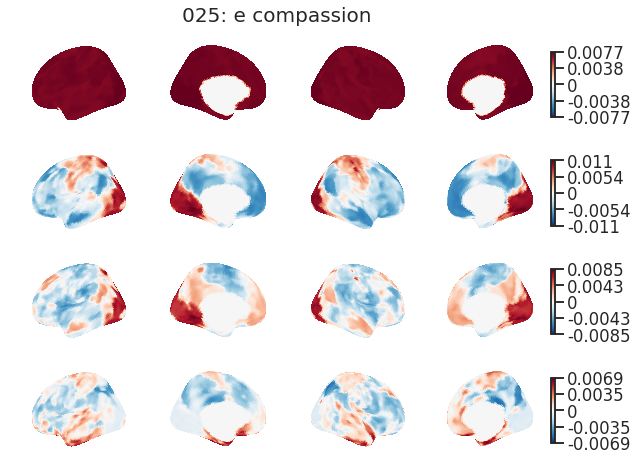

<Figure size 432x288 with 0 Axes>

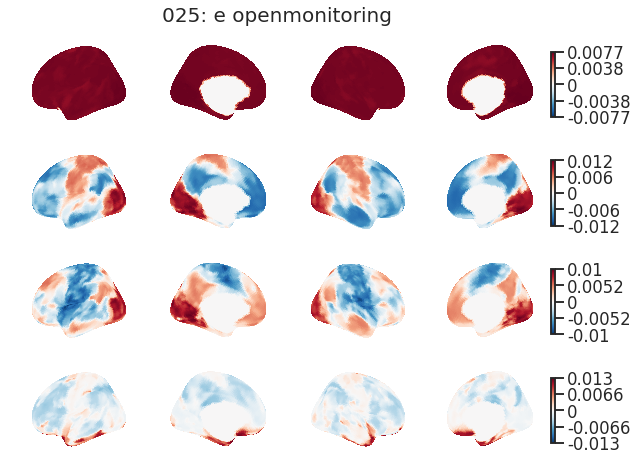

<Figure size 432x288 with 0 Axes>

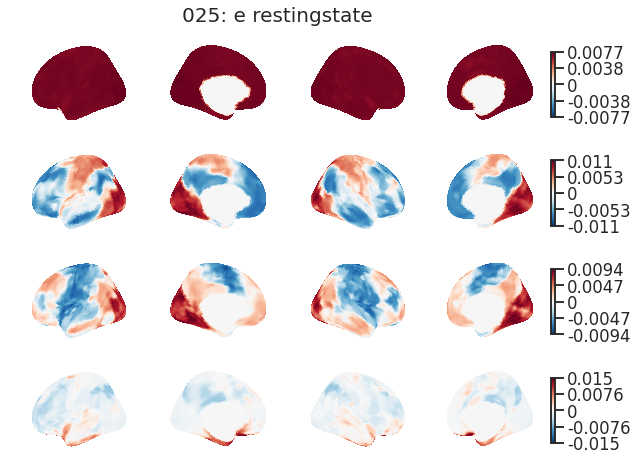

<Figure size 432x288 with 0 Axes>

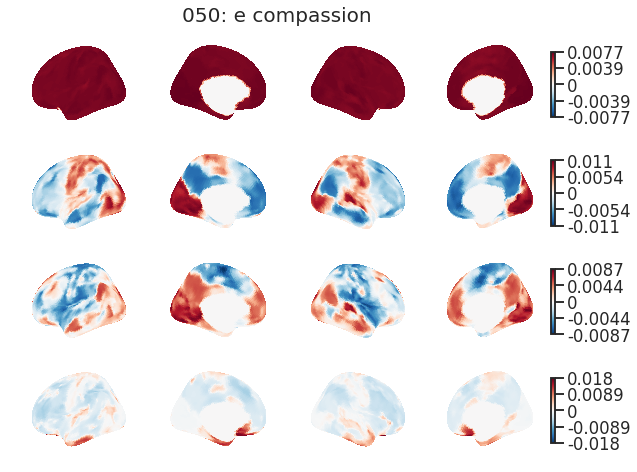

<Figure size 432x288 with 0 Axes>

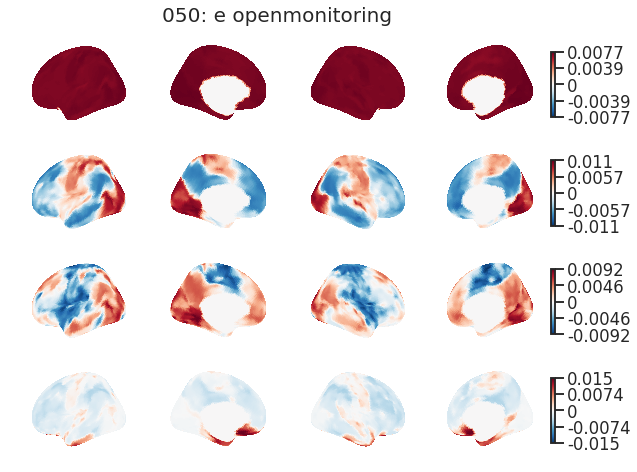

<Figure size 432x288 with 0 Axes>

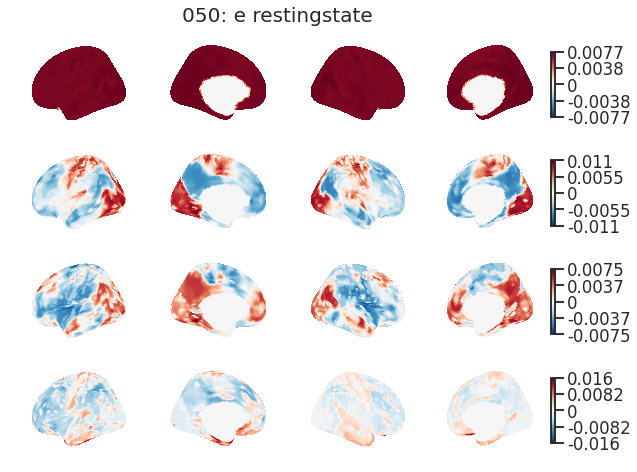

In [163]:
path = Path('/mnt/ssd3/ronan/data/mase_dmap_11-16')
flag = f"_mase_dmap"
ftype = "h5"
visualize(path, flag, ftype, n_embed=4, n_plot=6)

## GCCA o raw

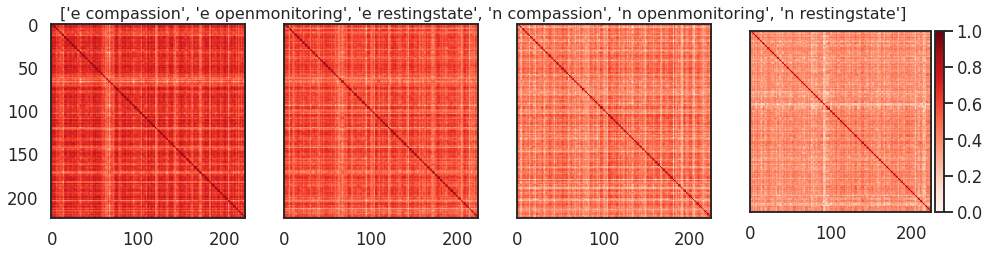

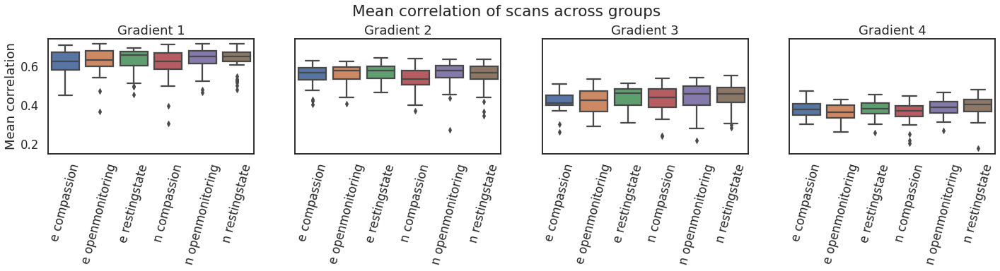

<Figure size 432x288 with 0 Axes>

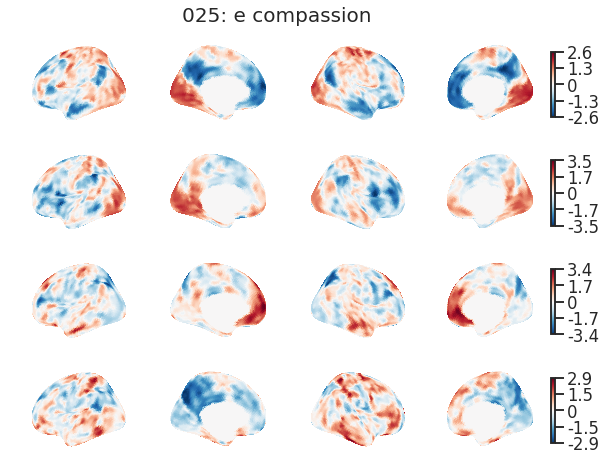

<Figure size 432x288 with 0 Axes>

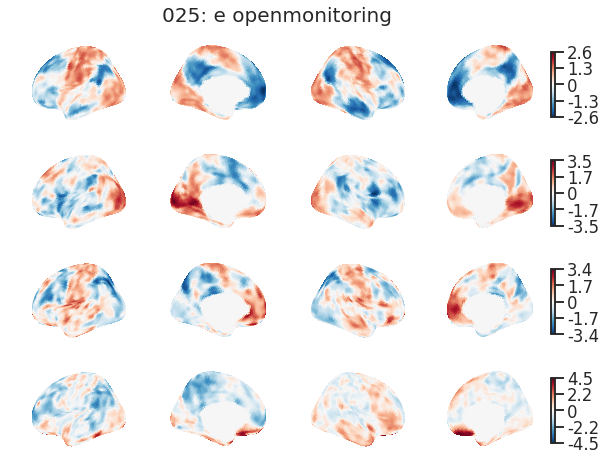

<Figure size 432x288 with 0 Axes>

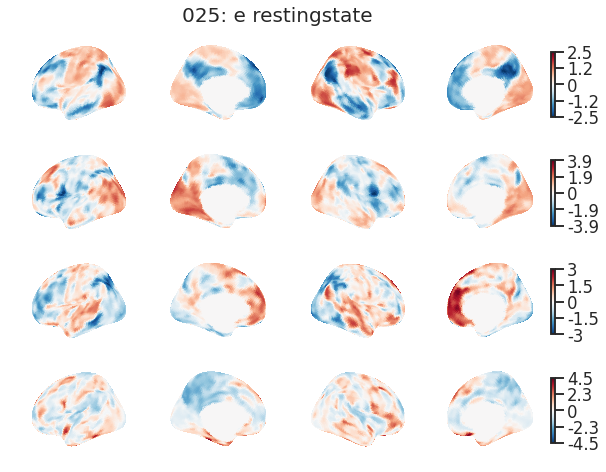

<Figure size 432x288 with 0 Axes>

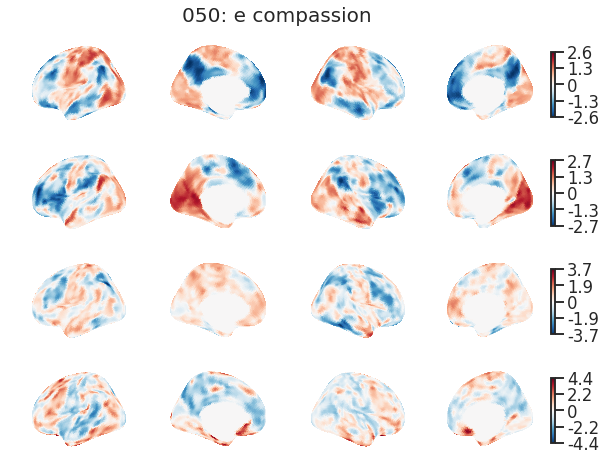

<Figure size 432x288 with 0 Axes>

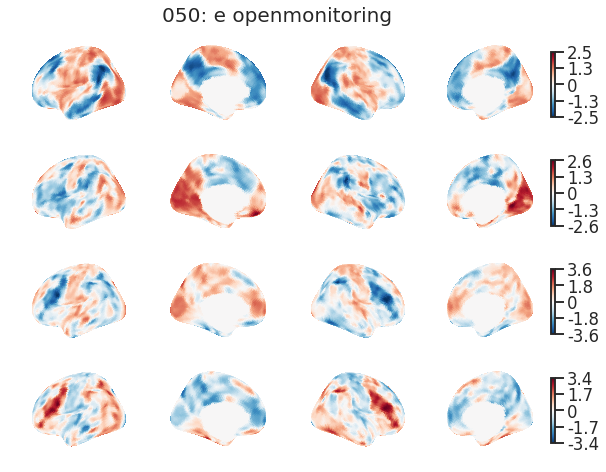

<Figure size 432x288 with 0 Axes>

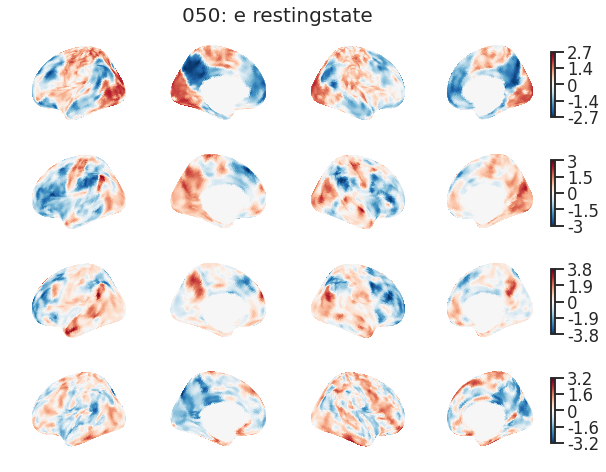

In [164]:
TAG = '_min_rank-ZG3_exclude-073'
path = Path(f"/mnt/ssd3/ronan/data/gcca_09-22-21:18{TAG}")
flag = f"_gcca"
ftype = "h5"
visualize(path, flag, ftype, n_embed=3, n_plot=6)

## GCCA (zg2 max) o raw

Norm mean: [14.96664455 14.96664175 14.96664348 14.9666475  14.9666653  14.96666856
 14.96666771 14.96667087], std: [0.00017088 0.00016046 0.00015943 0.00018759 0.00038498 0.00050767
 0.00042527 0.00038405]


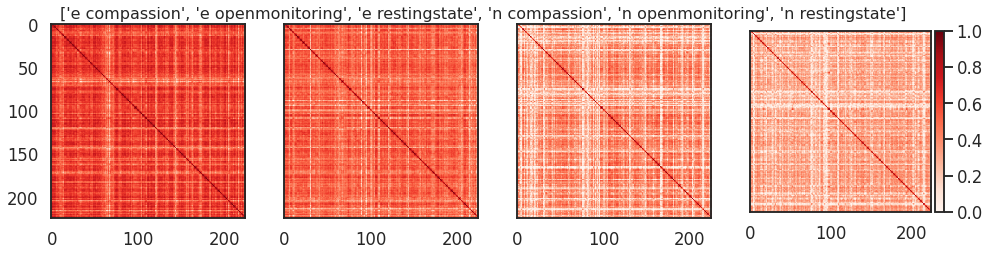

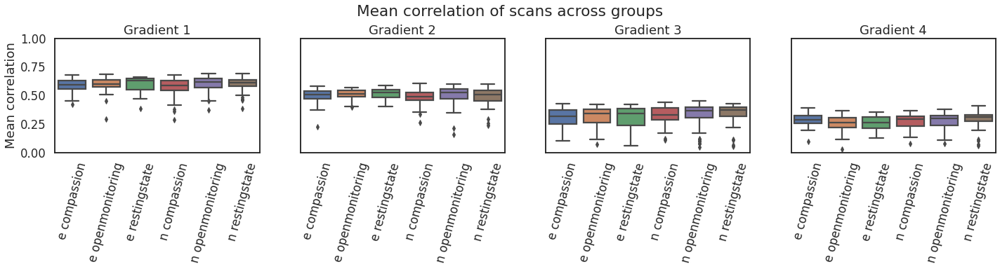

<Figure size 432x288 with 0 Axes>

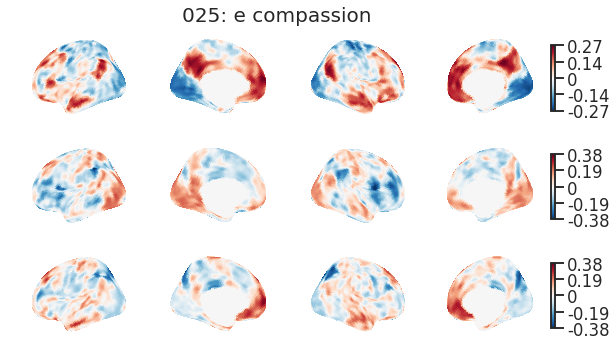

<Figure size 432x288 with 0 Axes>

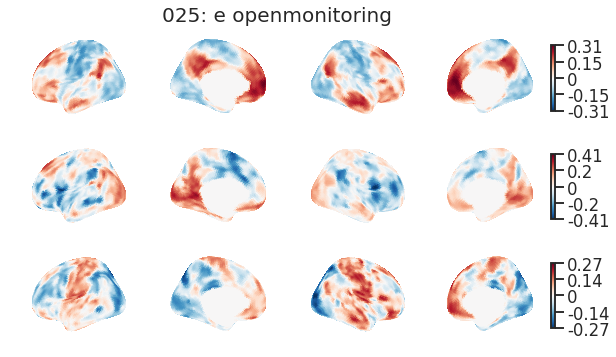

<Figure size 432x288 with 0 Axes>

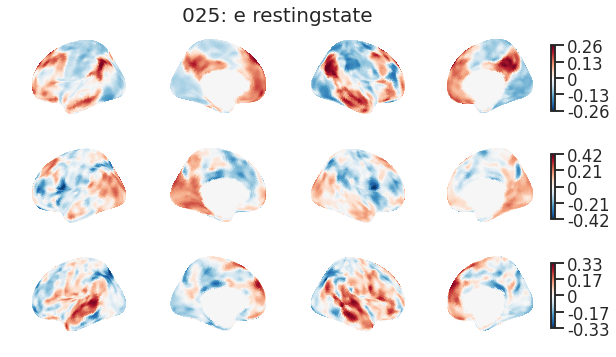

<Figure size 432x288 with 0 Axes>

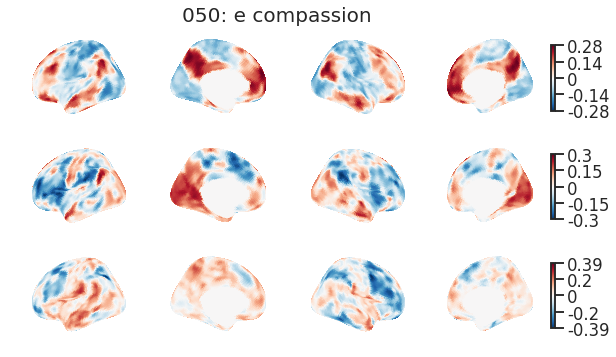

<Figure size 432x288 with 0 Axes>

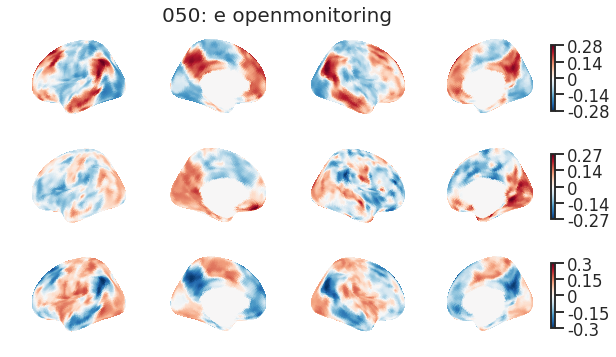

<Figure size 432x288 with 0 Axes>

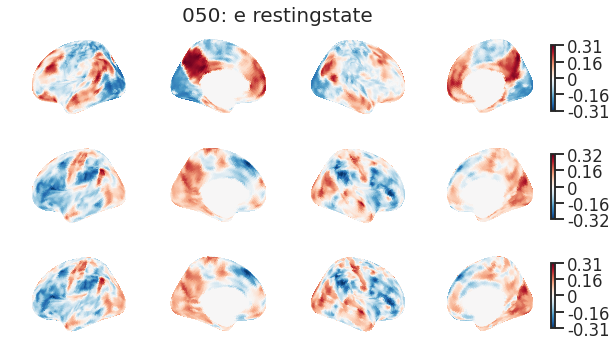

In [30]:
path = Path(f"/mnt/ssd3/ronan/data/gcca_raw_ZG2-max_12-09")
flag = f"_gcca"
ftype = "h5"
visualize(path, flag, ftype, n_embed=3, n_plot=6)

## GCCA o dmap

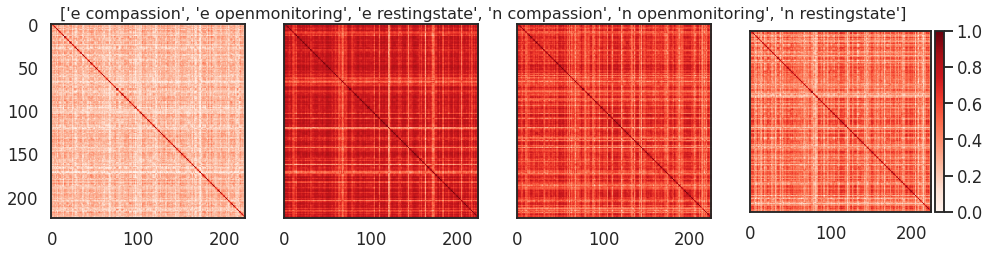

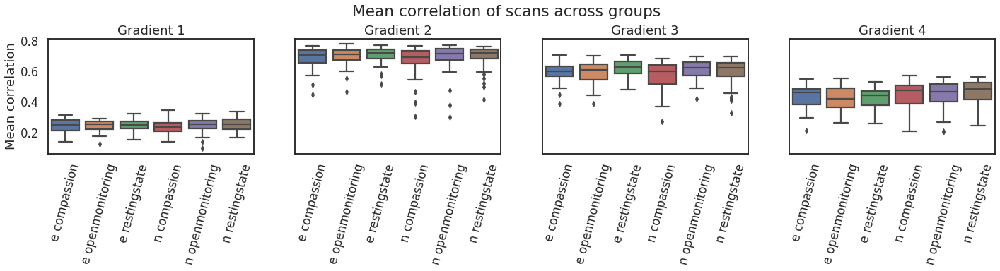

<Figure size 432x288 with 0 Axes>

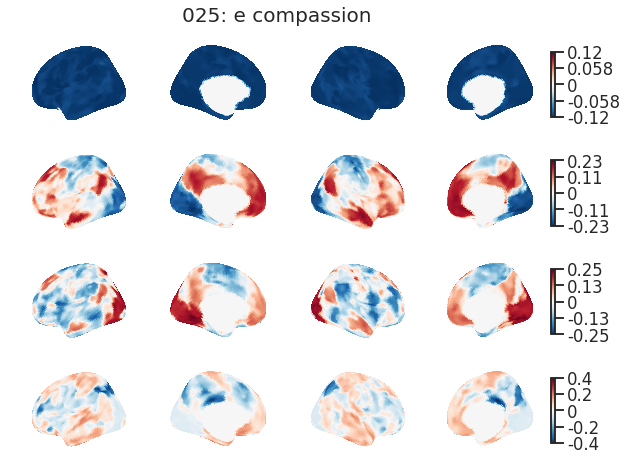

<Figure size 432x288 with 0 Axes>

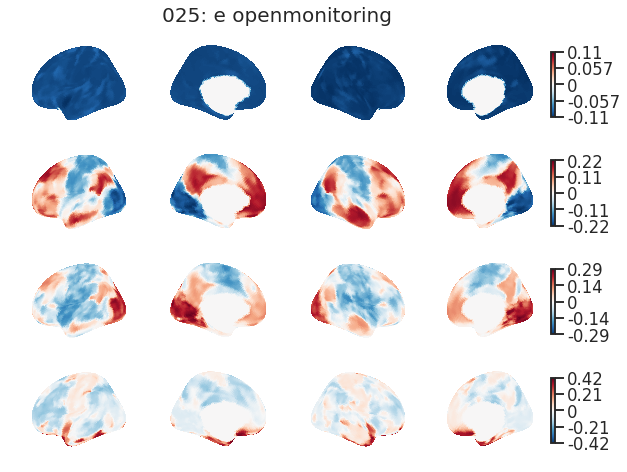

<Figure size 432x288 with 0 Axes>

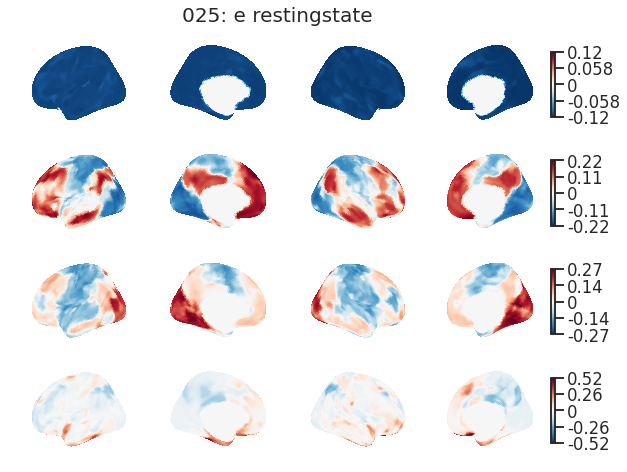

<Figure size 432x288 with 0 Axes>

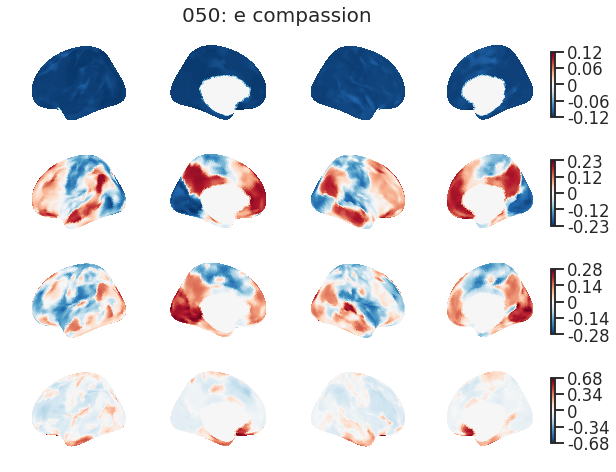

<Figure size 432x288 with 0 Axes>

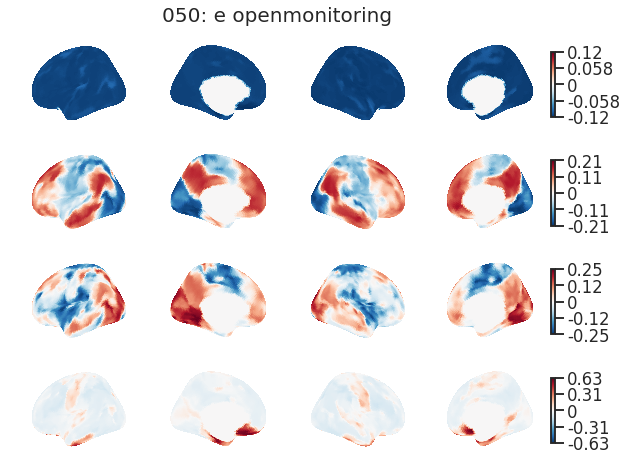

<Figure size 432x288 with 0 Axes>

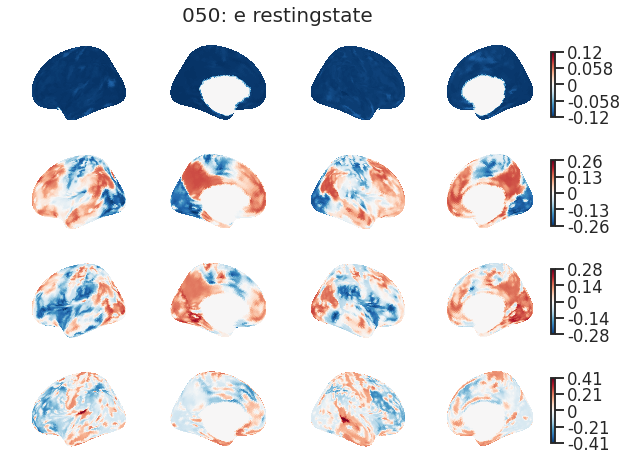

In [170]:
path = Path('/mnt/ssd3/ronan/data/gcca_dmap_ZG2_12-04')
flag = f"_gcca"
ftype = "h5"
visualize(path, flag, ftype, n_embed=4, n_plot=6)

## GCCA o centered dmap

Norm mean: [14.96662955 14.96662955 14.96662955 14.96662955 14.96662955 14.96662955
 14.96662955 14.96662955], std: [5.51533292e-14 5.13739542e-14 5.53267275e-14 5.17916935e-14
 5.07185739e-14 4.71567633e-14 5.14658671e-14 5.25694926e-14]


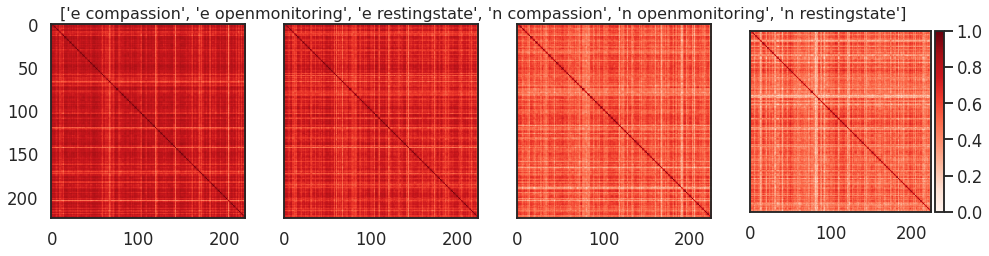

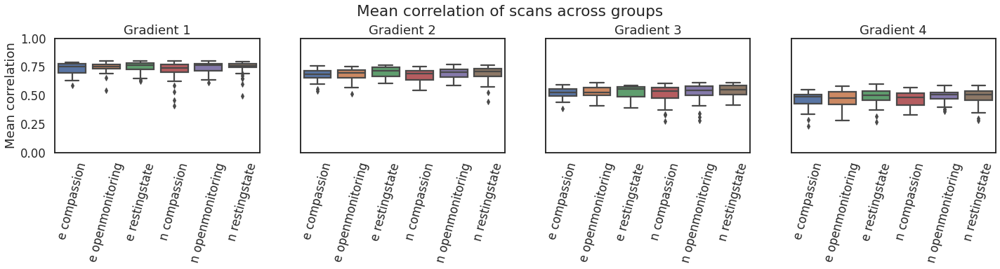

<Figure size 432x288 with 0 Axes>

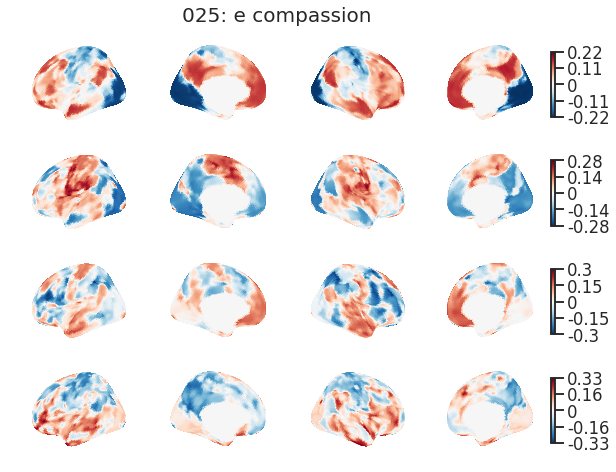

<Figure size 432x288 with 0 Axes>

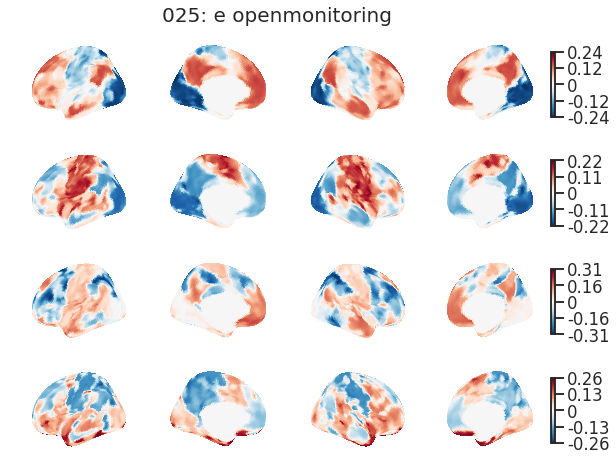

<Figure size 432x288 with 0 Axes>

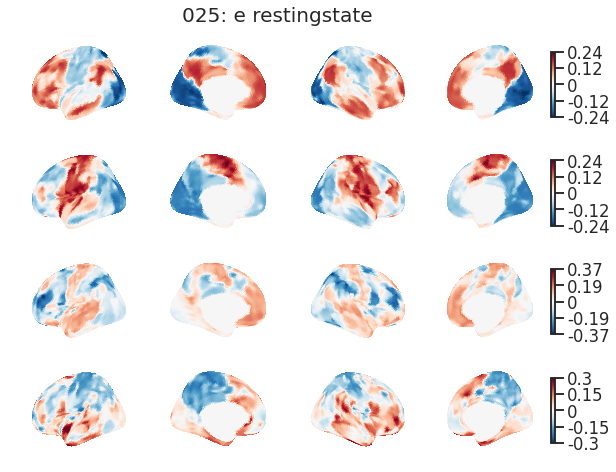

<Figure size 432x288 with 0 Axes>

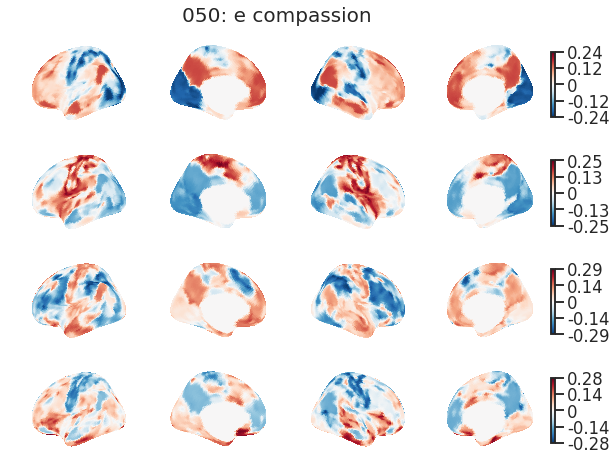

<Figure size 432x288 with 0 Axes>

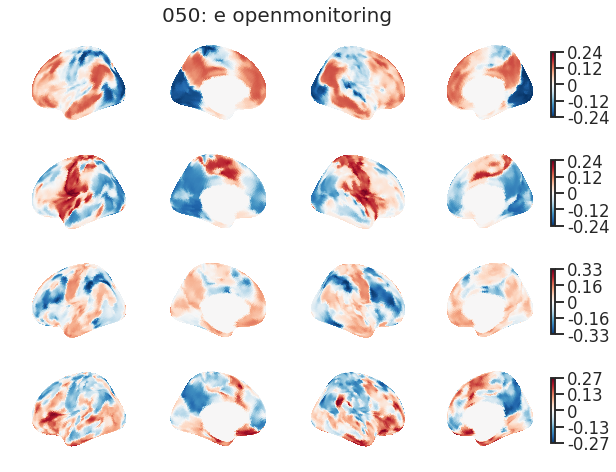

<Figure size 432x288 with 0 Axes>

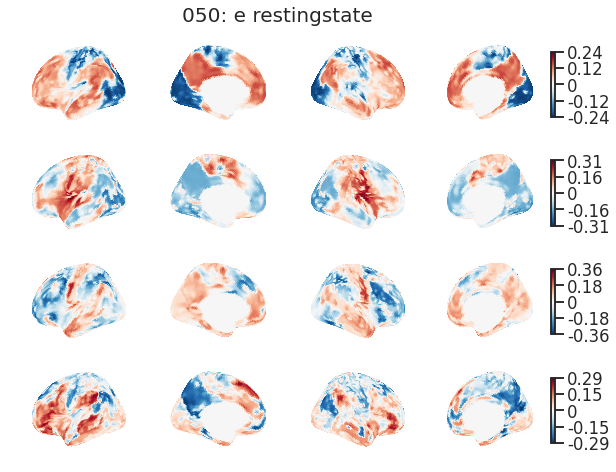

In [27]:
path = Path('/mnt/ssd3/ronan/data/gcca_dmap_centered_ZG3_12-03')
flag = f"_gcca"
ftype = "h5"
visualize(path, flag, ftype, n_embed=4, n_plot=6)

## Procrustes o SVD o raw

Norm mean: [1. 1. 1. 1. 1.], std: [3.11145161e-15 3.96185627e-15 4.29202004e-15 3.73140657e-15
 3.78278979e-15]


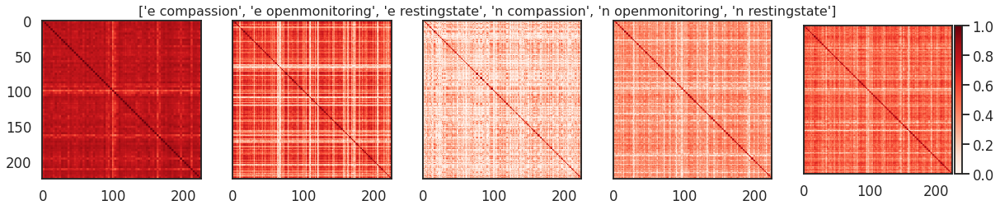

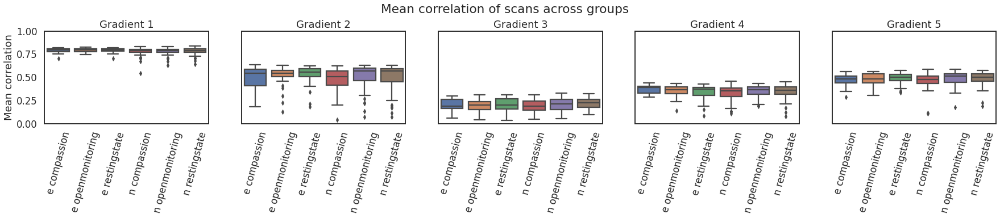

<Figure size 432x288 with 0 Axes>

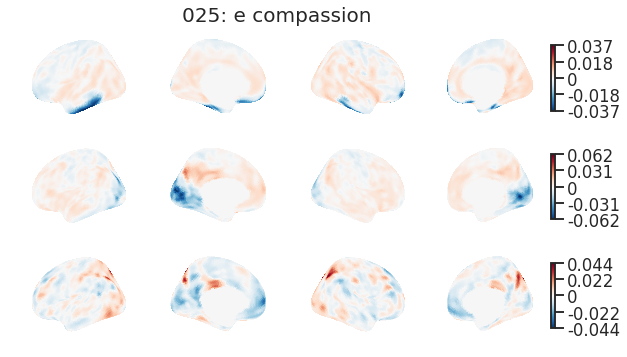

<Figure size 432x288 with 0 Axes>

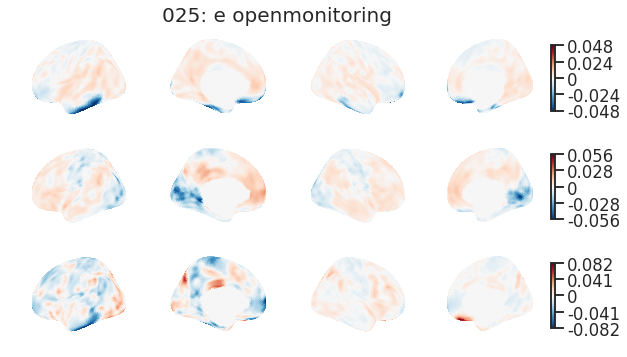

<Figure size 432x288 with 0 Axes>

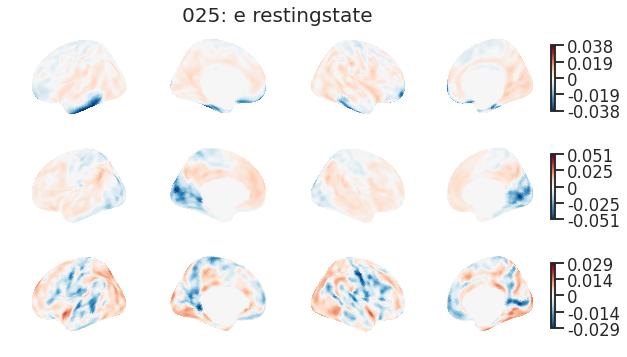

<Figure size 432x288 with 0 Axes>

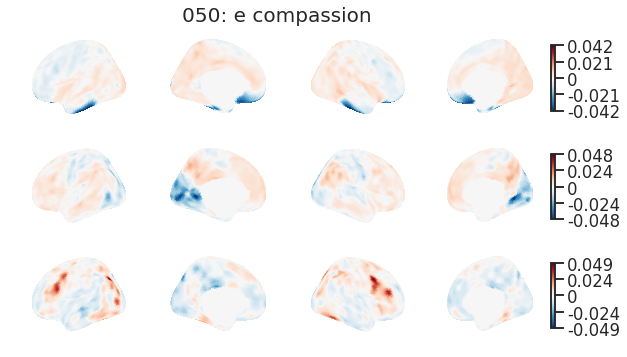

<Figure size 432x288 with 0 Axes>

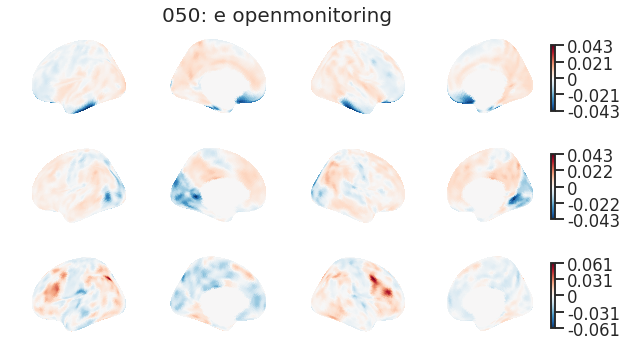

<Figure size 432x288 with 0 Axes>

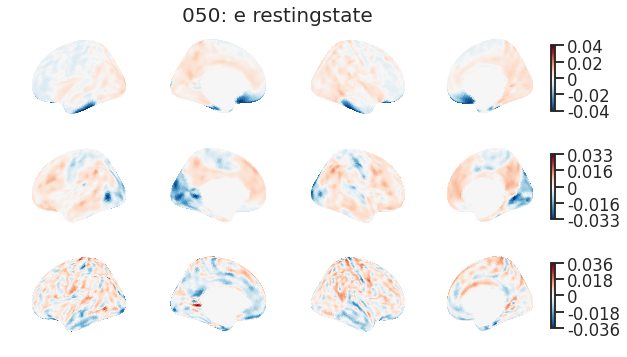

In [23]:
path = Path('/mnt/ssd3/ronan/data/svd_raw_aligned_12-07')
flag = f"_svd"
ftype = "h5"
visualize(path, flag, ftype, n_embed=3, n_viz=None, n_plot=6)

## Mean-procrustes o SVD o raw

Norm mean: [1. 1. 1. 1. 1.], std: [3.78733437e-15 4.84168135e-15 4.68384309e-15 4.18666462e-15
 4.10638465e-15]


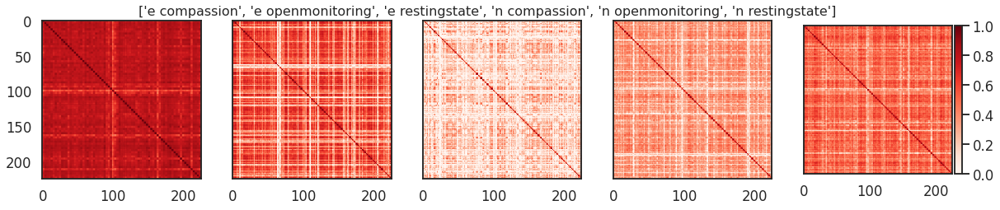

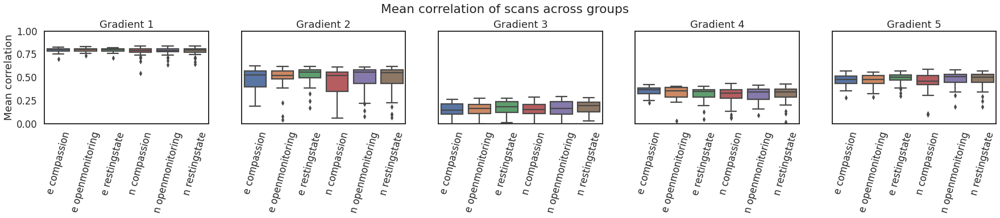

<Figure size 432x288 with 0 Axes>

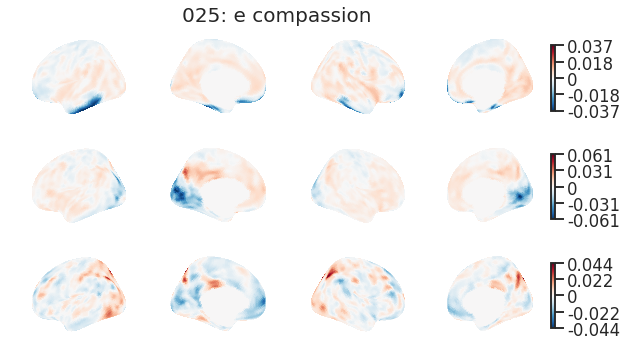

<Figure size 432x288 with 0 Axes>

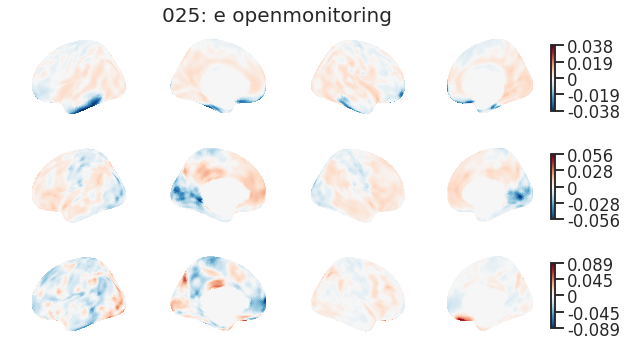

<Figure size 432x288 with 0 Axes>

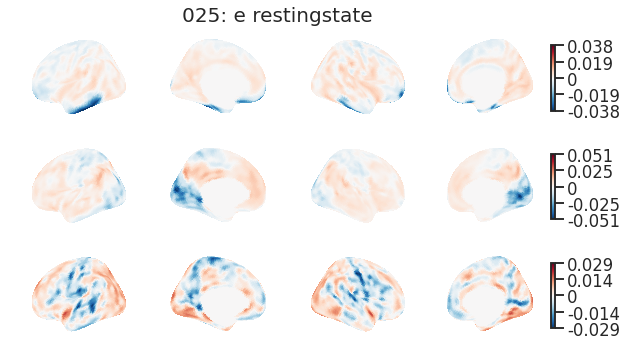

<Figure size 432x288 with 0 Axes>

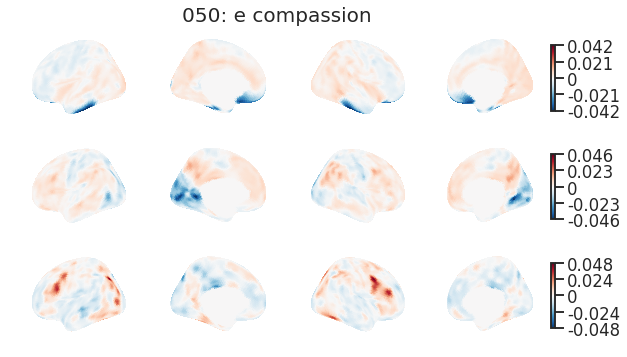

<Figure size 432x288 with 0 Axes>

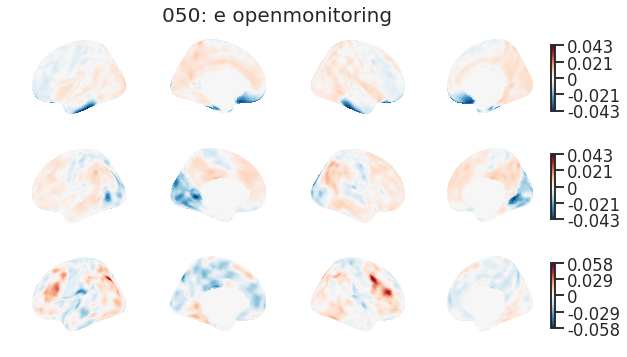

<Figure size 432x288 with 0 Axes>

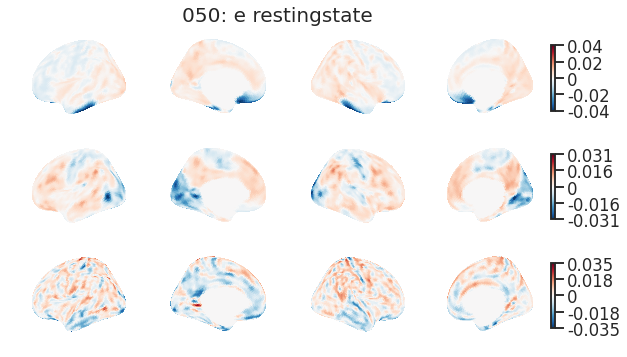

In [22]:
path = Path('/mnt/ssd3/ronan/data/svd_raw_mean-aligned_12-07')
flag = f"_svd"
ftype = "h5"
visualize(path, flag, ftype, n_embed=3, n_viz=None, n_plot=6)

In [ ]:
path = Path('/mnt/ssd3/ronan/data/svd_dmap_aligned_12-02')
flag = f"_svd"
ftype = "h5"
visualize(path, flag, ftype, n_embed=4, n_viz=None, n_plot=15)

## Procrustes o SVD o dmap

Norm mean: [1. 1. 1. 1. 1.], std: [2.37838922e-15 2.54783216e-15 2.73460650e-15 2.32260497e-15
 2.37686854e-15]


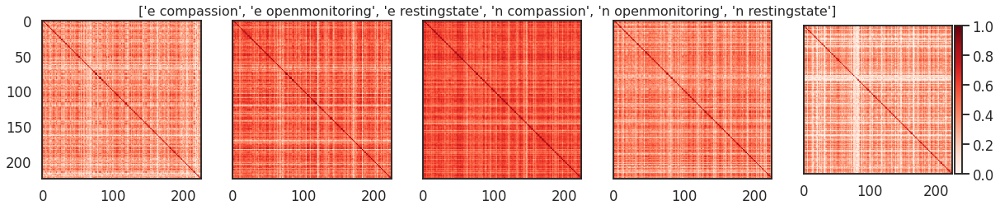

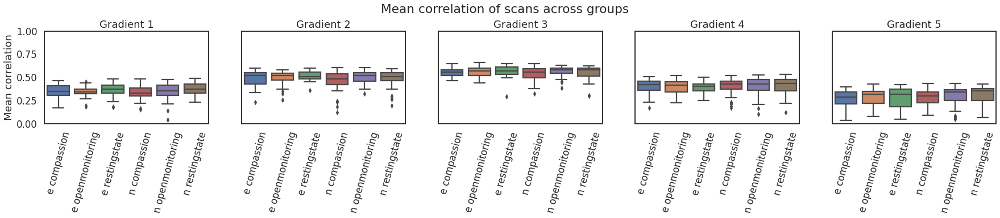

<Figure size 432x288 with 0 Axes>

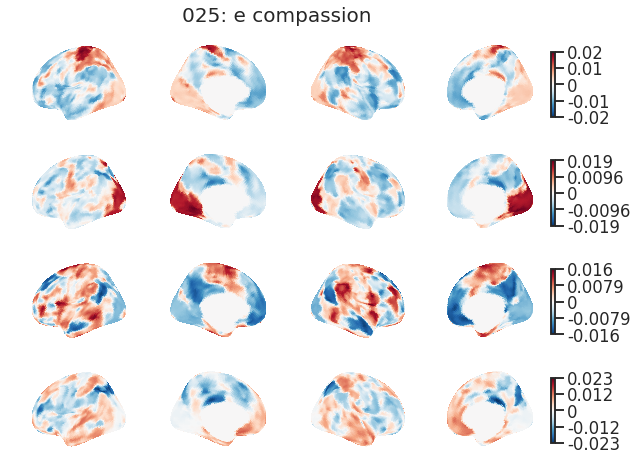

<Figure size 432x288 with 0 Axes>

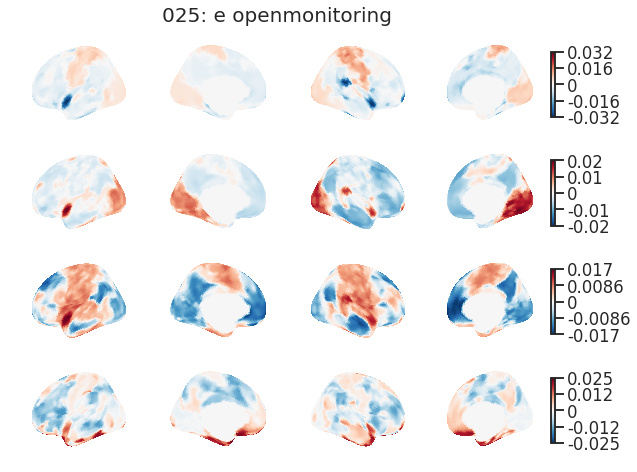

<Figure size 432x288 with 0 Axes>

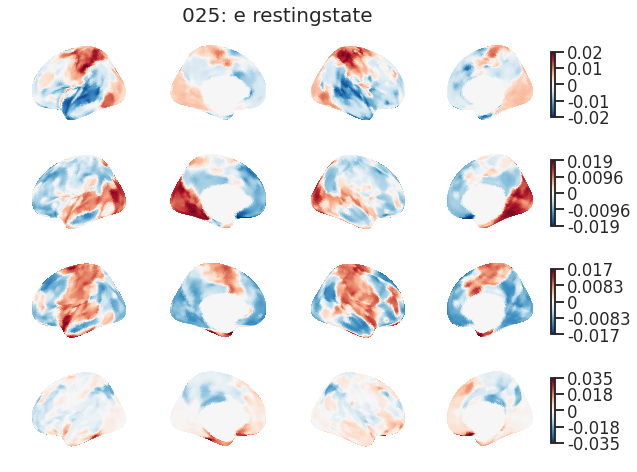

<Figure size 432x288 with 0 Axes>

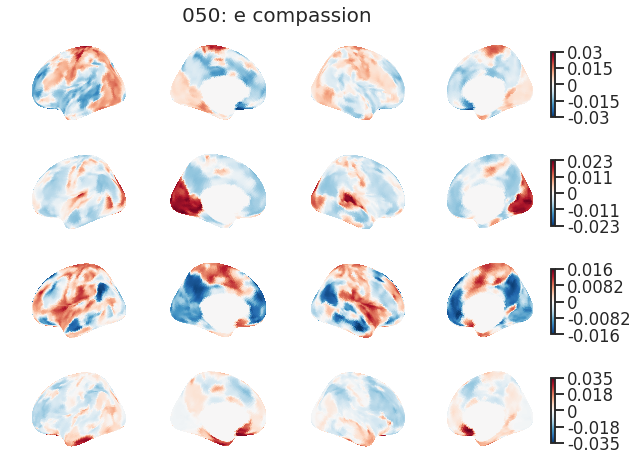

<Figure size 432x288 with 0 Axes>

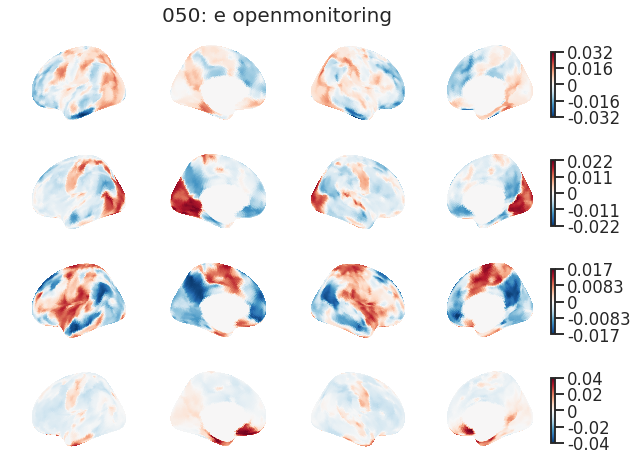

<Figure size 432x288 with 0 Axes>

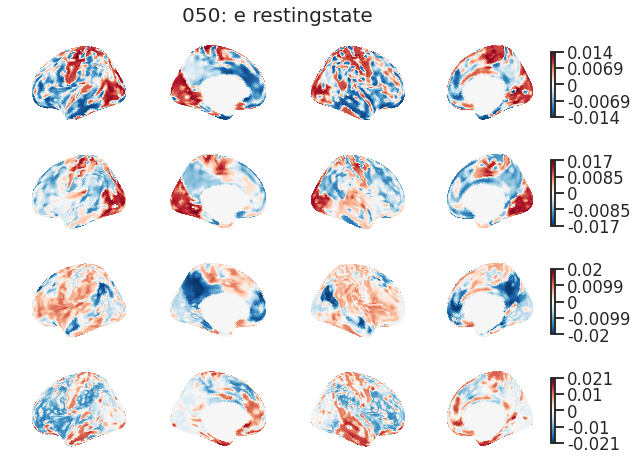

<Figure size 432x288 with 0 Axes>

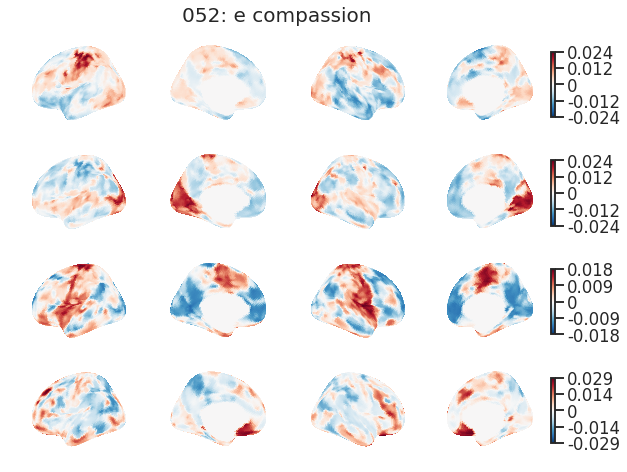

<Figure size 432x288 with 0 Axes>

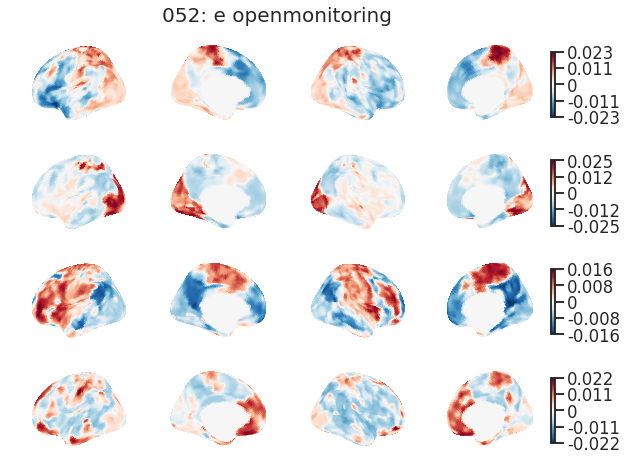

<Figure size 432x288 with 0 Axes>

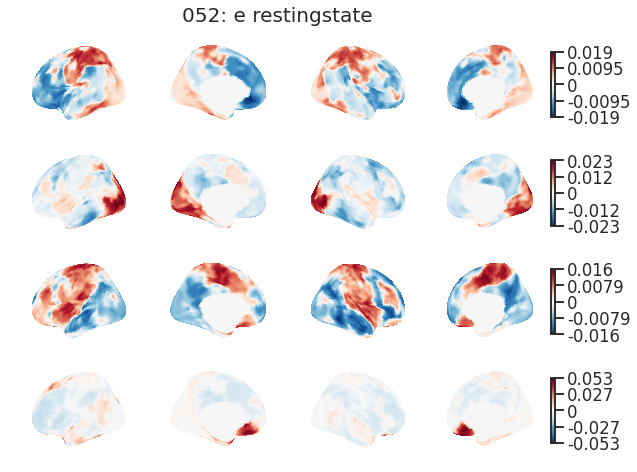

<Figure size 432x288 with 0 Axes>

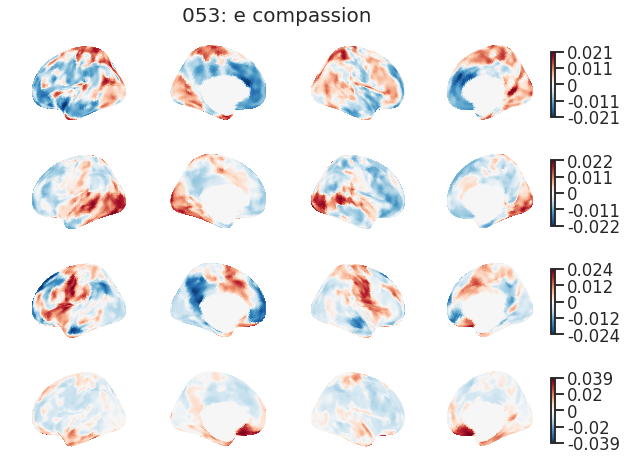

<Figure size 432x288 with 0 Axes>

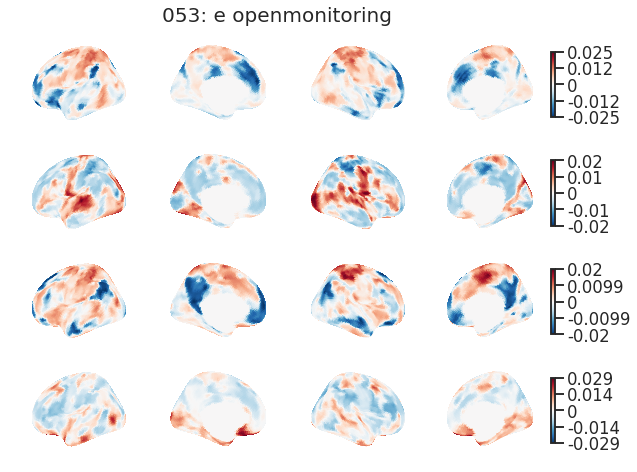

<Figure size 432x288 with 0 Axes>

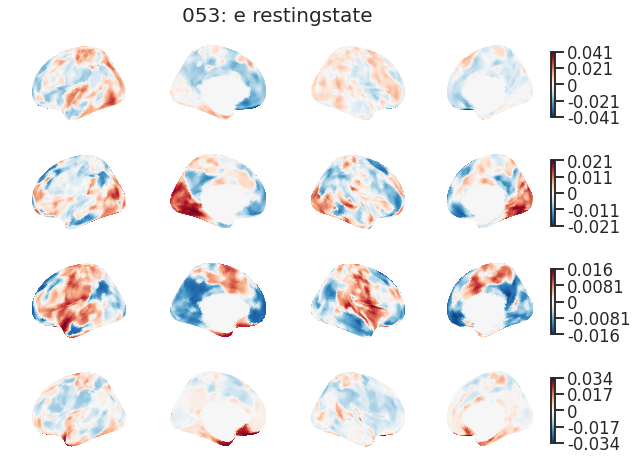

<Figure size 432x288 with 0 Axes>

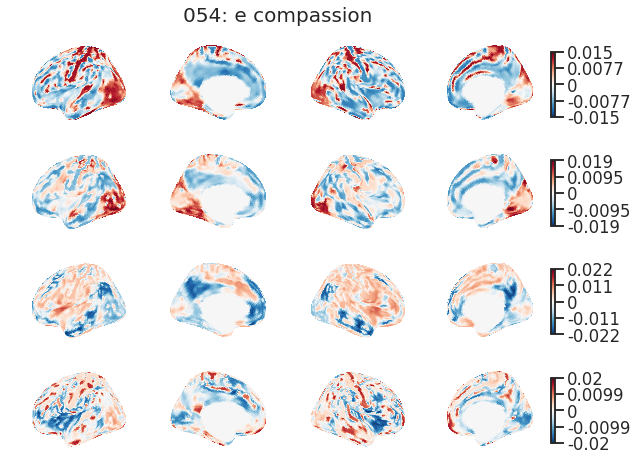

<Figure size 432x288 with 0 Axes>

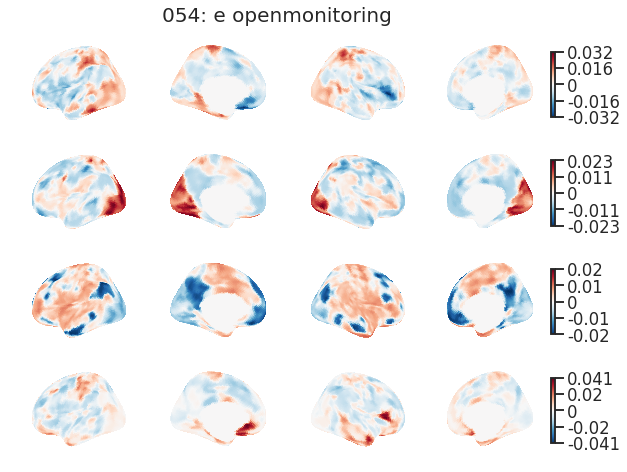

<Figure size 432x288 with 0 Axes>

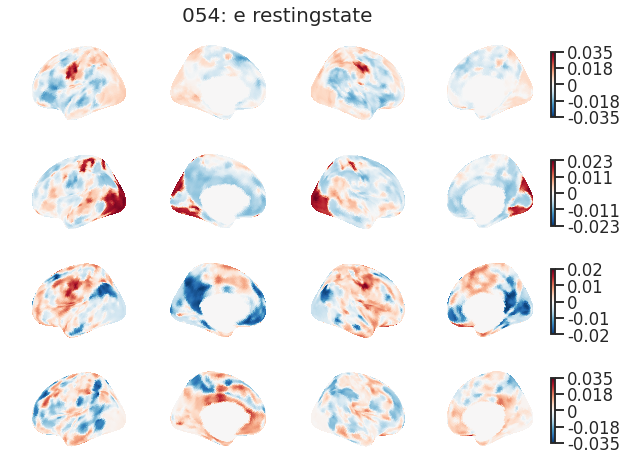

In [25]:
path = Path('/mnt/ssd3/ronan/data/svd_dmap_aligned_12-08')
flag = f"_svd"
ftype = "h5"
visualize(path, flag, ftype, n_embed=4, n_viz=None, n_plot=15)

## mean-Procrustes o SVD o dmap

Norm mean: [1. 1. 1. 1. 1.], std: [3.02816708e-15 2.85757786e-15 3.25064336e-15 2.78533006e-15
 2.74916170e-15]


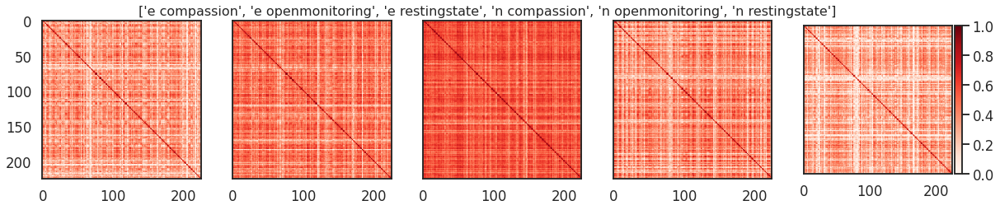

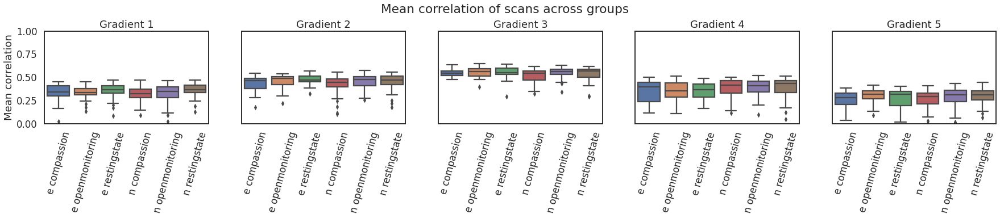

<Figure size 432x288 with 0 Axes>

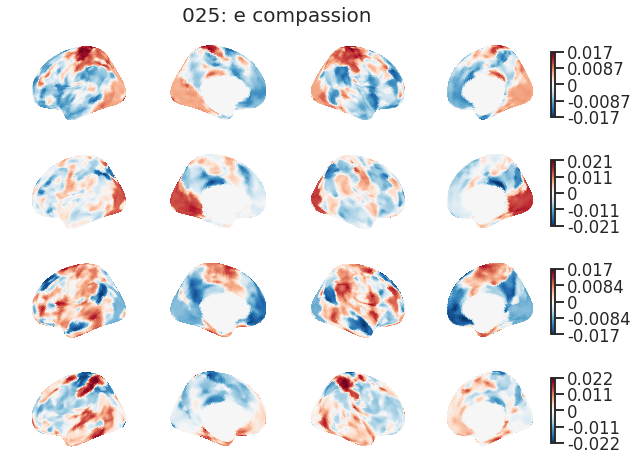

<Figure size 432x288 with 0 Axes>

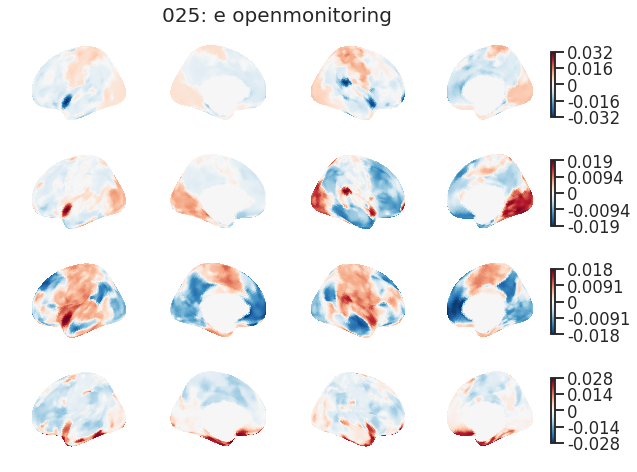

<Figure size 432x288 with 0 Axes>

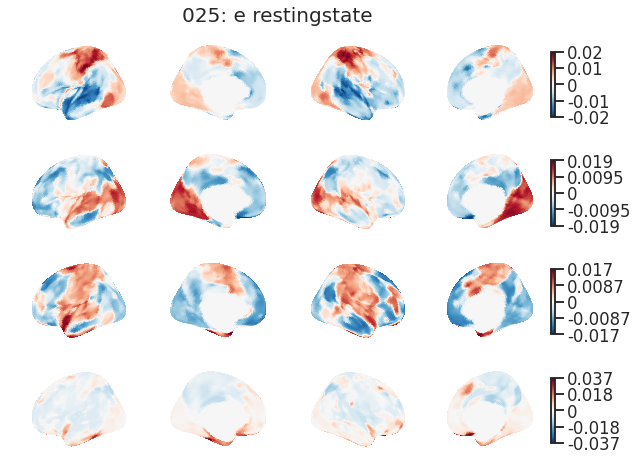

<Figure size 432x288 with 0 Axes>

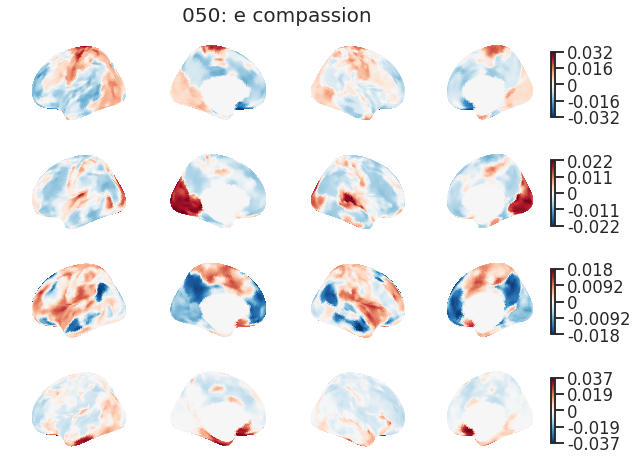

<Figure size 432x288 with 0 Axes>

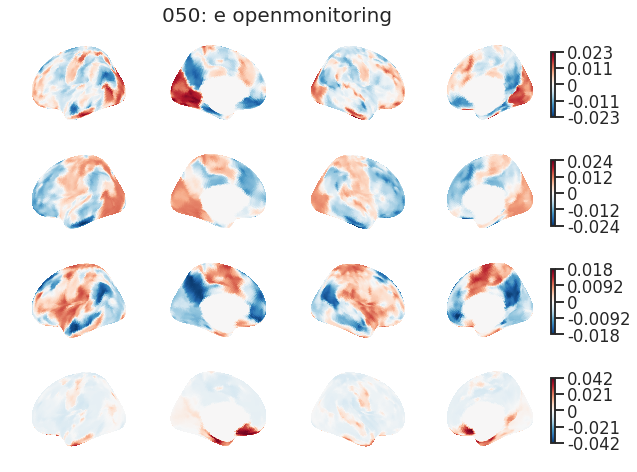

<Figure size 432x288 with 0 Axes>

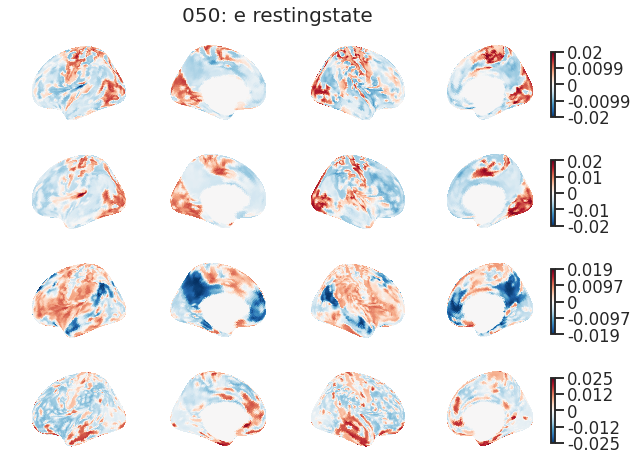

<Figure size 432x288 with 0 Axes>

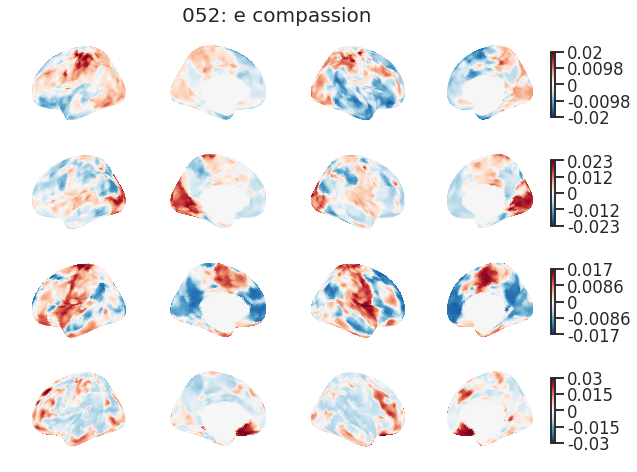

<Figure size 432x288 with 0 Axes>

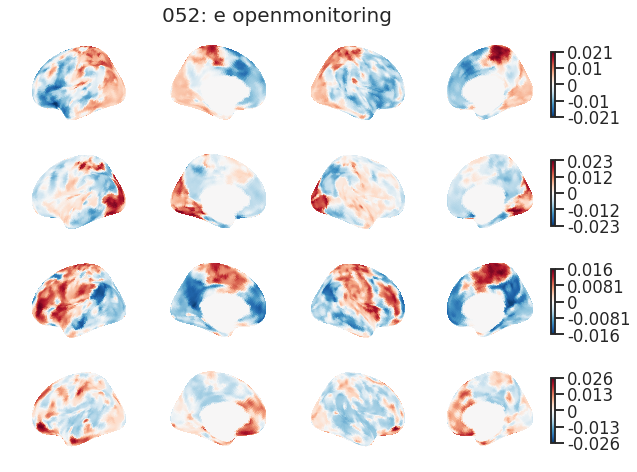

<Figure size 432x288 with 0 Axes>

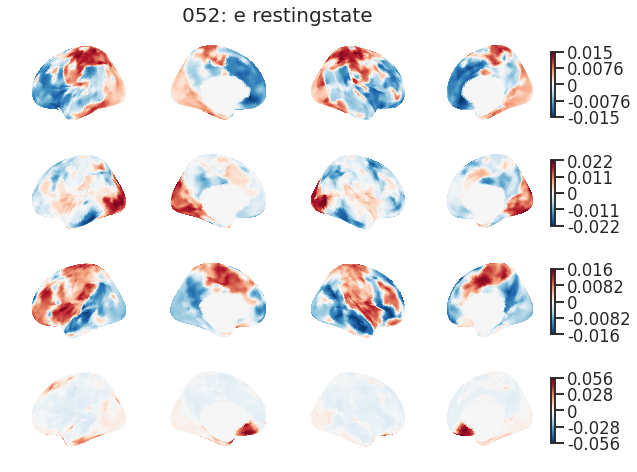

<Figure size 432x288 with 0 Axes>

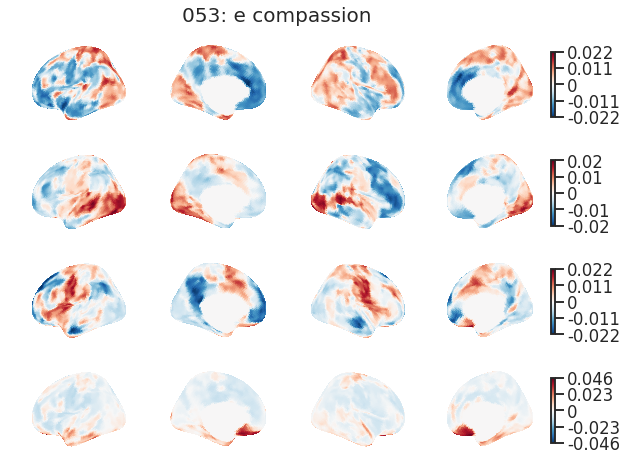

<Figure size 432x288 with 0 Axes>

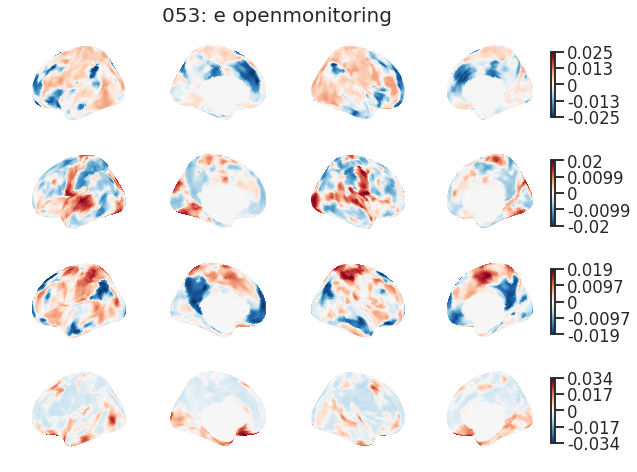

<Figure size 432x288 with 0 Axes>

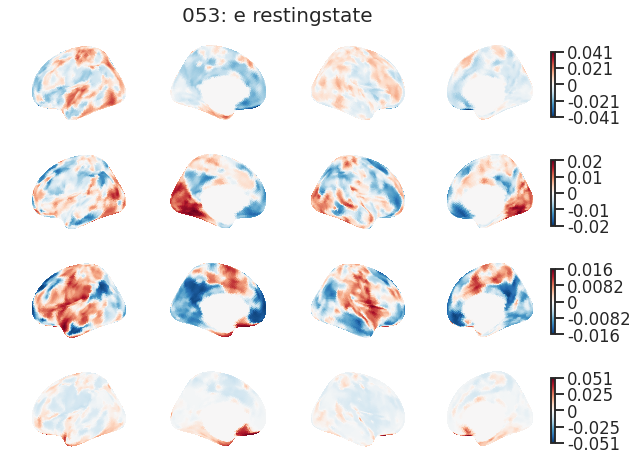

<Figure size 432x288 with 0 Axes>

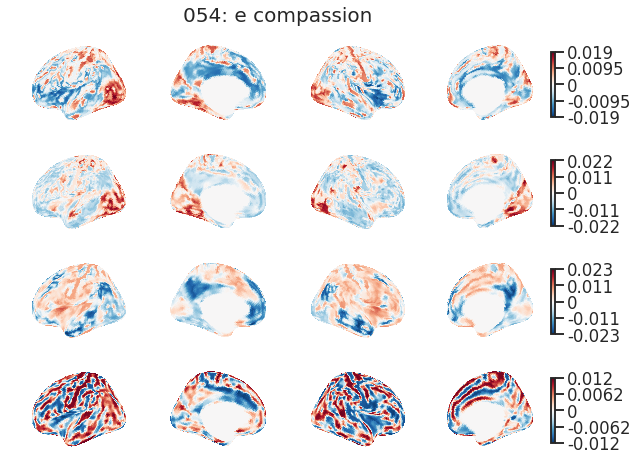

<Figure size 432x288 with 0 Axes>

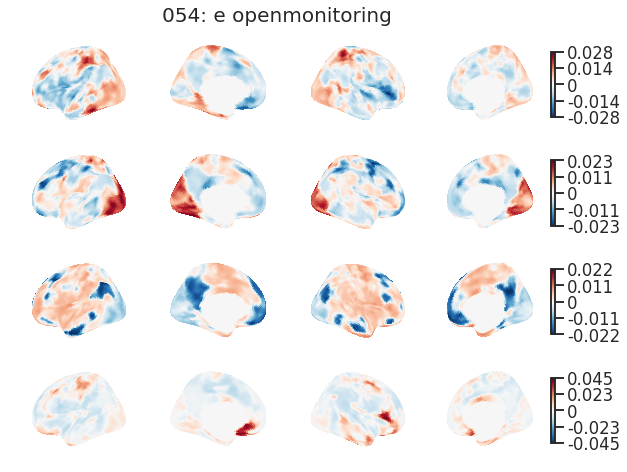

<Figure size 432x288 with 0 Axes>

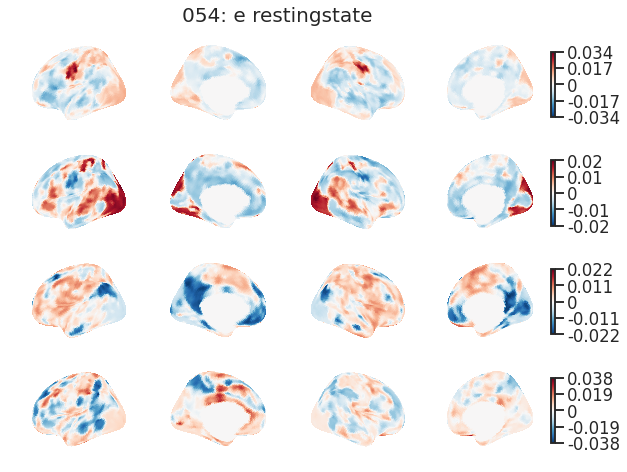

In [26]:
path = Path('/mnt/ssd3/ronan/data/svd_dmap_mean-aligned_12-08')
flag = f"_svd"
ftype = "h5"
visualize(path, flag, ftype, n_embed=4, n_viz=None, n_plot=15)

## Raw DMAP check

In [17]:
path = Path('/mnt/ssd3/ronan/data/dmap_09-04_raw')
flag = '_emb'
ftype = 'npy'
source='dmap'

path = Path('/mnt/ssd3/ronan/data/svd_dmap_12-02')
flag = f"_svd"
ftype = "h5"
source='gcca'

n_embed=3
offset=0
n_viz=4
n_plot=6

groups, labels, subjs = get_latents(
    path, flag=flag, ids=True, ftype=ftype, source=source, as_groups=False
)

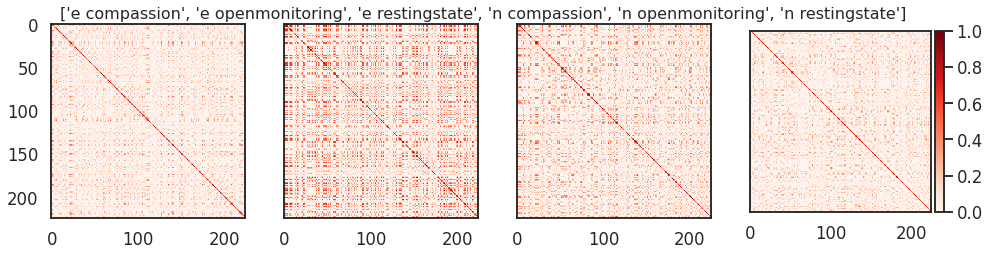

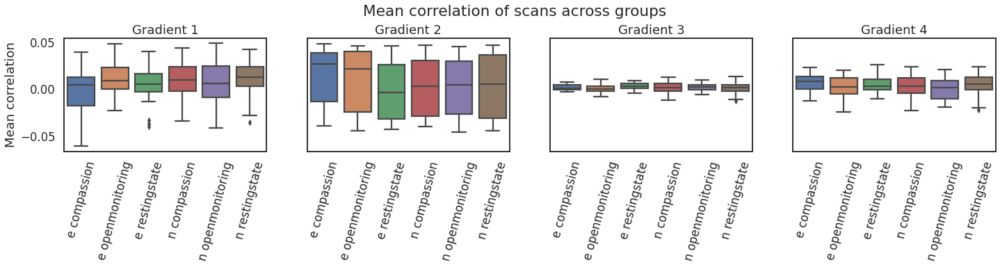

<Figure size 432x288 with 0 Axes>

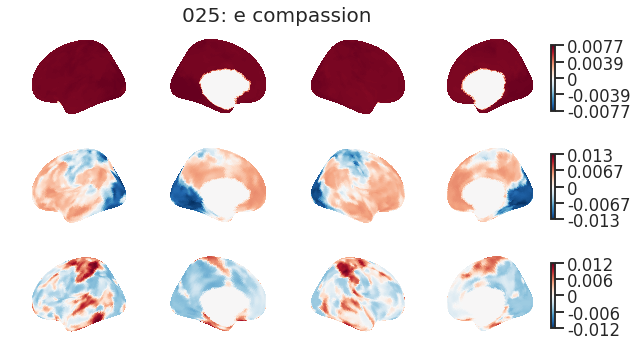

<Figure size 432x288 with 0 Axes>

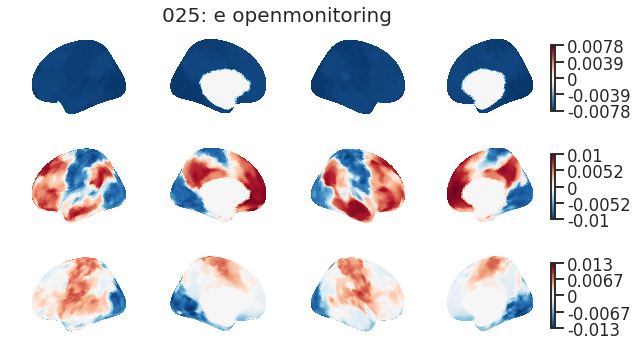

<Figure size 432x288 with 0 Axes>

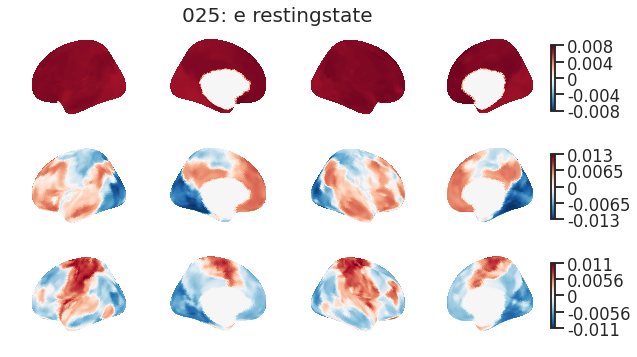

<Figure size 432x288 with 0 Axes>

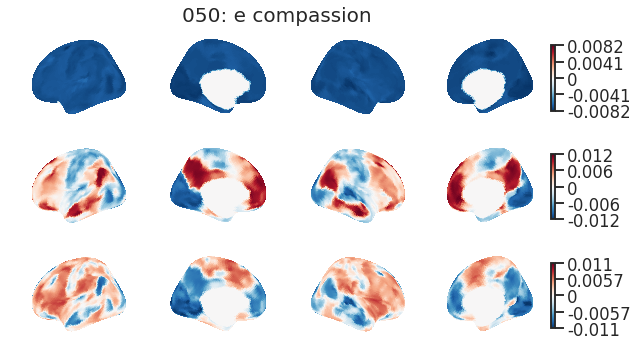

<Figure size 432x288 with 0 Axes>

KeyboardInterrupt: 

In [18]:
# Hierarchical sorting
key_list = [[l[0] for l in labels], [s for s in subjs], [l[1] for l in labels]]
key_list = [np.asarray(kl) for kl in key_list]
idx_list = [np.arange(len(groups))]
for keys in key_list:
    prior_idx = idx_list
    idx_list = []
    for idxs in prior_idx:
        nkeys = keys[idxs]
        sort_idxs = np.argsort(nkeys)
        nkeys = nkeys[sort_idxs]
        idx_list += [idxs[sort_idxs[np.where(nkeys == k)[0]]] for k in np.unique(nkeys)]

idx = np.hstack(idx_list)
Xs, subjs, labels = groups[idx], subjs[idx], labels[idx]

if n_viz is None:
    n_viz = Xs.shape[-1]

f, axs = plt.subplots(1, n_viz, figsize=(n_viz*4,4), sharey=True)

label_list = [f'{a} {b}' for a, b in labels]
#idx = np.argsort(label_list)
for i in range(n_viz):
    ax = axs[i]
    im = ax.imshow(np.corrcoef(Xs[:,:,i+offset]), vmin=0, vmax=1, cmap='Reds')
#         heatmap(
#             np.corrcoef(Xs[:,:,i+offset]),#[idx][:, idx],
#             inner_hier_labels=None,# if i==0 else None,
#             #outer_hier_labels=subjs,
#             figsize=(4,4),
#             ax=axs[i]
#         )
    if i == n_viz-1:
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
    # plt.colorbar(im, ax=axs[i], cmap='seismic')
plt.suptitle([label_list[i] for i in sorted(np.unique(label_list, return_index=True)[1])], fontsize=16, y=0.90)

classes = np.asarray([f"{a} {b}" for a, b in labels])
f, axs = plt.subplots(1, n_viz, figsize=(n_viz*6,3), sharey=True)
for i in range(n_viz):
    mean_corrs = np.corrcoef(Xs[:,:,i+offset]).mean(axis=0)
    set_labels, set_means = list(zip(*[(cls, mean_corrs[np.where(classes == cls)[0]]) for cls in np.unique(classes)]))

    sns.boxplot(data=set_means, ax=axs[i])
    axs[i].set_title(f'Gradient {i+1}')
    # axs[i].set_yticklabels([])
    axs[i].set_xticklabels(set_labels, rotation=75)

axs[0].set_ylabel('Mean correlation')

#axs[-1].set_xticks(plt.xticks()[0], set_labels, kwargs={'rotation': 75})
plt.suptitle('Mean correlation of scans across groups', y=1.1)
plt.show()

SAVE = False
COLORBAR = True

for i, (X, subj, (trait, state)) in enumerate(zip(Xs, subjs, labels)):
    if i >= n_plot:
        break
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, offset:n_embed+offset],
        save_path=False,
        colorbar=COLORBAR,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()